## Part - 1 - Topics to be covered


## [1. Contours](#1)
    - 1. What are contours
    - 2. Applications of contours
    - 3. Contour detection using opencv
    - 4. Contour properties -> How contours are different from edges
    

## [2. Project - Find extreme points in image containing hand](#2)


## [3. Project - Contour based shape detection](#3)

In [3]:
# Imports
import os
import sys
sys.path.append("monk_v1/monk/");

In [4]:
%matplotlib inline

<a id='1'></a>
# Contours

## Image Contours

In [5]:
print("Use slider to change slides")
# Slide section 1
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=1, min=1, max=4);

def f(slide_num):
    img_name = "imgs/imgs/chapter6/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=1, description='slide_num', max=4, min=1), Output()), _dom_classes=('wid…

## 2. Contour detection using opencv

In [6]:
# Detecting contours using opencv

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);


# Write a function to convert img from BGR to Grayscale
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY )

In [7]:
thresh = cv2.adaptiveThreshold(imgray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)

In [8]:
#ret,thresh = cv2.threshold(imgray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);


In [9]:
# drawing contours over blank image
ctr = np.zeros(img.shape, dtype=np.uint8);
cv2.drawContours(ctr, contours, -1, (0,255,0), 3);

# drawing contours over original image
img_with_contours = img.copy();
cv2.drawContours(img_with_contours, contours, -1, (0,255,0), 3); # Talk about (0, 255, 0) colors

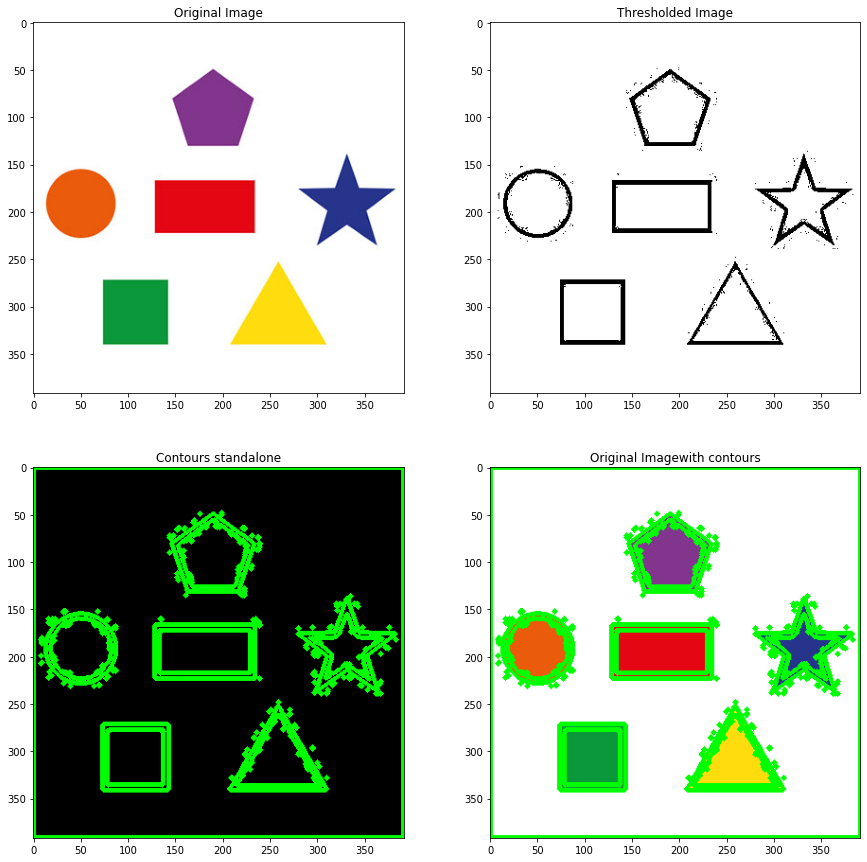

In [10]:
f = plt.figure(figsize=(15,15))
f.add_subplot(2, 2, 1).set_title('Original Image');
plt.imshow(img[:,:,::-1]);
f.add_subplot(2, 2, 2).set_title('Thresholded Image');
plt.imshow(thresh, cmap="gray");
f.add_subplot(2, 2, 3).set_title('Contours standalone');
plt.imshow(ctr[:,:,::-1]);
f.add_subplot(2, 2, 4).set_title('Original Imagewith contours');
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

In [11]:
# Interactive demo - 1
# Understanding the approximations
from matplotlib import pyplot as plt
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import cv2
import numpy as np
lst = [cv2.CHAIN_APPROX_NONE, cv2.CHAIN_APPROX_SIMPLE, cv2.CHAIN_APPROX_TC89_L1, cv2.CHAIN_APPROX_TC89_KCOS]
sl1 = widgets.SelectionSlider(value=cv2.CHAIN_APPROX_SIMPLE, options=lst);

def f(contour_approx):
    img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);
    imgray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY);
    thresh = cv2.adaptiveThreshold(imgray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    #ret,thresh = cv2.threshold(imgray,127,255,0)
    contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,contour_approx);

    ctr = np.zeros(img.shape, dtype=np.uint8);
    cv2.drawContours(img, contours, -1, (0,255,0), 1);
    
    plt.figure(figsize=(15, 15));
    plt.imshow(img[:,:,::-1], cmap = "gray")
    plt.show()

interact(f, contour_approx=sl1);

interactive(children=(SelectionSlider(description='contour_approx', index=1, options=(1, 2, 3, 4), value=2), O…

# Retrieval methods

 - CV_RETR_EXTERNAL gives "outer" contours, so if you have (say) one contour enclosing another (like concentric circles), only the outermost is given.
 
- CV_RETR_LIST gives all the contours and doesn't even bother calculating the hierarchy -- good if you only want the contours and don't care whether one is nested inside another.

- CV_RETR_CCOMP gives contours and organises them into outer and inner contours. Every contour is either the outline of an object, or the outline of an object inside another object (i.e. hole). The hierarchy is adjusted accordingly. This can be useful if (say) you want to find all holes.

- CV_RETR_TREE calculates the full hierarchy of the contours. So you can say that object1 is nested 4 levels deep within object2 and object3 is also nested 4 levels deep.

## Contour properties
    - 1. Contour Moments
    - 2. Contour Area -> Area Enclosed inside a closed contour in pixels
    - 3. Contour Perimeter - Number of pixels a contour covers in pixels
    - 4. Contour approximation
        - Approximating the shape of a contour from an irregular shape
    - 5. Convex Hull
    - 6. Bounding rectangle, cicle, eclipse fitting accross a contour

### Contour Moments
    - Moments are a set of statistical parameters to measure a distribution. 
    - Three moments are commonly used: 
        - 1st, Mean: the average. 
        - 2d, Variance: an indication of how closely the values are spread about the mean.
        - 3rd, Standard deviation is the square root of the variance

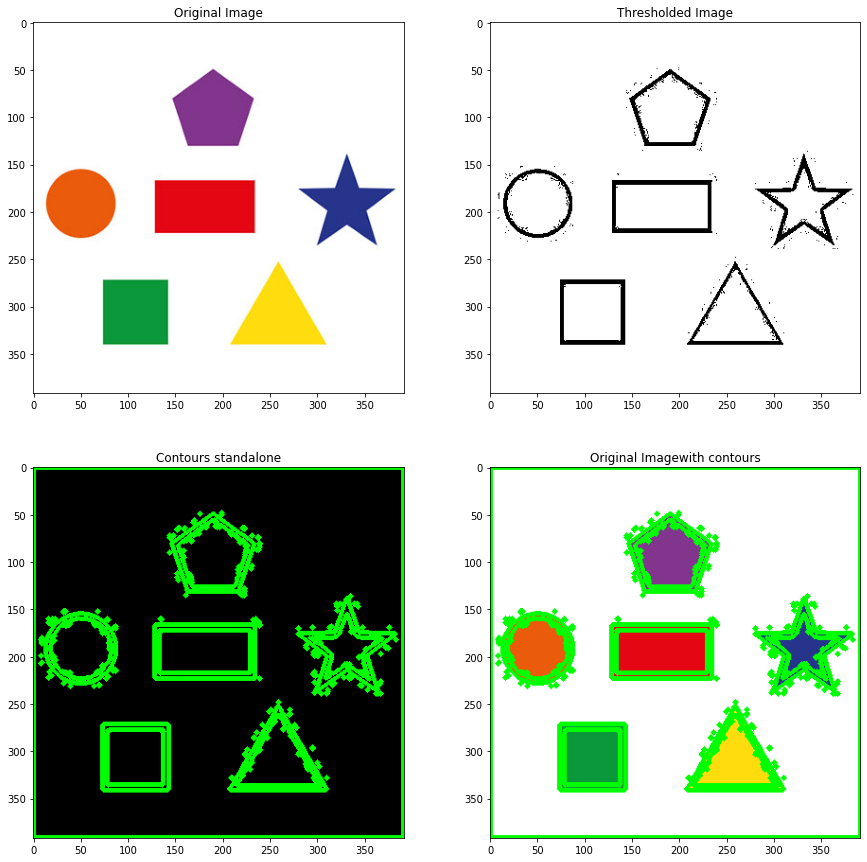

In [12]:
# Detecting contours

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);

# STEP -1 Convert img from BGR Space to Grayscale space
imgray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY);


thresh = cv2.adaptiveThreshold(imgray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)


# Write function to find contours
# - Retrieval - TREE
# - Approximation - Simple
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);

# drawing contours over blank image
ctr = np.zeros(img.shape, dtype=np.uint8);
cv2.drawContours(ctr, contours, -1, (0,255,0), 3);

# drawing contours over original image
img_with_contours = img.copy();
cv2.drawContours(img_with_contours, contours, -1, (0,255,0), 3); # Talk about (0, 255, 0) colors

f = plt.figure(figsize=(15,15))
f.add_subplot(2, 2, 1).set_title('Original Image');
plt.imshow(img[:,:,::-1]);
f.add_subplot(2, 2, 2).set_title('Thresholded Image');
plt.imshow(thresh, cmap="gray");
f.add_subplot(2, 2, 3).set_title('Contours standalone');
plt.imshow(ctr[:,:,::-1]);
f.add_subplot(2, 2, 4).set_title('Original Imagewith contours');
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

In [13]:
print("Number of contours = {}".format(len(contours)));

Number of contours = 262


In [14]:
# Interactive demo - 1
# Trying to isolate valid contours

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets


sl1 = widgets.IntSlider(value=109, min=0, max=len(contours));

def f(contour_num):
    img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);
    ctr = np.zeros(img.shape, dtype=np.uint8);
    cv2.drawContours(ctr, contours, contour_num, (0,255,0), 3);
    cv2.drawContours(img, contours, contour_num, (0,255,0), 3);
    
    f = plt.figure(figsize=(15,15))
    f.add_subplot(1, 2, 1).set_title('Contour Image');
    plt.imshow(ctr[:,:,::-1]);
    f.add_subplot(1, 2, 2).set_title('Contour on original Image');
    plt.imshow(img[:,:,::-1]);

interact(f, contour_num=sl1);

interactive(children=(IntSlider(value=109, description='contour_num', max=262), Output()), _dom_classes=('widg…

### Image moments
    - Image moments help you to calculate some features like center of mass of the object, area of the object etc. 
    

In [15]:
# Contour Moments
cnt = contours[109] # Change value and check
M = cv2.moments(cnt)
print(M)

{'m00': 6045.0, 'm10': 1094411.3333333333, 'm01': 1175752.5, 'm20': 203802623.5, 'm11': 212863004.3333333, 'm02': 230321857.0, 'm30': 38948835638.6, 'm21': 39639610270.75, 'm12': 41698529210.45, 'm03': 45434781533.25, 'mu20': 5665954.099099368, 'mu11': 0.0, 'mu02': 1637995.75, 'mu30': 6907.108200073242, 'mu21': -9.5367431640625e-07, 'mu12': 125469.31198167801, 'mu03': 0.0, 'nu20': 0.15505309569186074, 'nu11': 0.0, 'nu02': 0.04482498575270527, 'nu30': 2.4311149628899743e-06, 'nu21': -3.3566752296055203e-16, 'nu12': 4.416179867269681e-05, 'nu03': 0.0}


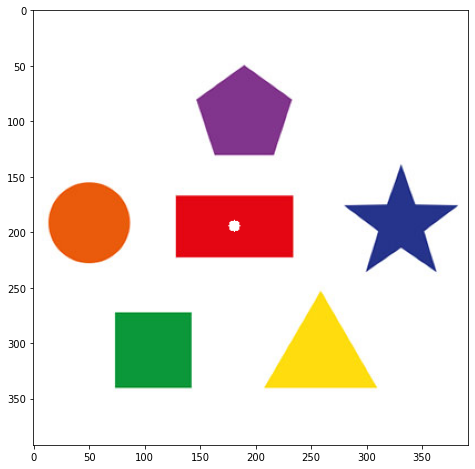

In [16]:
# Using some moments to find centroid of an object
# We selected 110th contour which represents the rectangle
cx = int(M['m10']/M['m00'])
cy = int(M['m01']/M['m00'])

cv2.circle(img,(int(cx), int(cy)), 5, (255,255,255), -1)

plt.figure(figsize=(8, 8));
plt.imshow(img[:,:,::-1]);
plt.show();

### Contour Area

In [17]:
# Contour Area
cnt = contours[109]
area = cv2.contourArea(cnt)
print(area)

6045.0


In [18]:
# List of areas of all contours
lst_arr = [];
for cnt in contours:
    lst_arr.append(cv2.contourArea(cnt))

print("Minimum area = {}".format(min(lst_arr)));
print("Maximum area = {}".format(max(lst_arr)));

Minimum area = 0.0
Maximum area = 152881.0


In [19]:
print(lst_arr)

[152881.0, 2.0, 4.0, 2.0, 2.0, 6.0, 2.0, 4.0, 4.0, 2.0, 2.0, 2.0, 2.0, 4898.0, 3420.5, 2.0, 5.5, 2.0, 2.0, 2.0, 4644.0, 0.0, 3315.5, 4.0, 2.0, 4.0, 2.0, 2.0, 2.0, 4.0, 2.0, 4.0, 4.0, 2.0, 2.0, 2.0, 2.0, 5.5, 4.0, 7.0, 4.0, 4.0, 4.0, 0.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0, 4.0, 2.0, 2.0, 2.0, 4.0, 2.0, 2.0, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0, 2.0, 2.0, 2.0, 15.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 6045.0, 4316.0, 2.0, 4.0, 2.0, 2.0, 5.5, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 5.5, 2.0, 2.0, 2.0, 2.0, 4301.5, 0.0, 0.0, 3155.5, 2.0, 7.0, 2.0, 4.0, 4.0, 4.0, 4.0, 2.0, 2.0, 4.0, 2.0, 4.0, 4.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 6.0, 2.0, 4.0, 4.0, 5.5, 7.5, 4.0, 2.0, 7.5, 2.0, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 3598.5, 0.0, 0.0, 1803.5, 4.0, 2.0, 5.5, 2.0, 4.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0, 2.0, 4.0, 4.0, 2.0, 4.0, 4.0, 4.0, 4.0, 2.0, 2.0

In [20]:
# Interactive demo - 2
# Removing contours as per their areas

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets


sl1 = widgets.IntText(value=0, description='Minimum area:')

def f(threshold):
    img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);
    for i in range(len(contours)):
        if(lst_arr[i] > threshold):
            cv2.drawContours(img, contours, i, (0,255,0), 3);
    plt.figure(figsize=(8, 8));
    plt.imshow(img[:,:,::-1])
    plt.show()

interact(f, threshold=sl1);

#Check these values
#0-14
#4000
#4600
#4900
#5000

interactive(children=(IntText(value=0, description='Minimum area:'), Output()), _dom_classes=('widget-interact…

### Contour Perimeter

In [21]:
# Contour Perimeter
cnt = contours[109]
perimeter = cv2.arcLength(cnt, True) # True -> closed length
print(perimeter)


326.48528122901917


In [22]:
# List of perimeters of all contours
lst_per = [];
for cnt in contours:
    lst_per.append(cv2.arcLength(cnt, True))

print("Minimum perimeter = {}".format(min(lst_per)));
print("Maximum perimeter = {}".format(max(lst_per)));

Minimum perimeter = 0.0
Maximum perimeter = 1564.0


In [23]:
# Interactive demo - 2
# Filtering contours as per their lengths

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets


sl1 = widgets.IntText(value=0, description='Minimum area:')

def f(threshold):
    img = cv2.imread("imgs/imgs/chapter6/shape.jpg", 1);
    for i in range(len(contours)):
        if(lst_per[i] > threshold):
            cv2.drawContours(img, contours, i, (0,255,0), 3);
    plt.figure(figsize=(8, 8));
    plt.imshow(img[:,:,::-1])
    plt.show()

interact(f, threshold=sl1);

#Check these values
#0-14
#270
#290
#310
#330
# Star has minimum area but maximum contour length

interactive(children=(IntText(value=0, description='Minimum area:'), Output()), _dom_classes=('widget-interact…

### Contour Approximation based on length

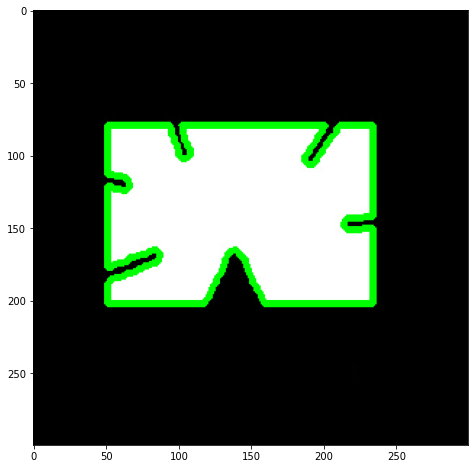

In [24]:
# Contour Approximation

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter6/contours.jpg", 0);




thresh = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)



contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);


# drawing contours over original image
img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.drawContours(img_with_contours, contours, 6, (0,255,0), 3); # Talk about (0, 255, 0) colors


plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()







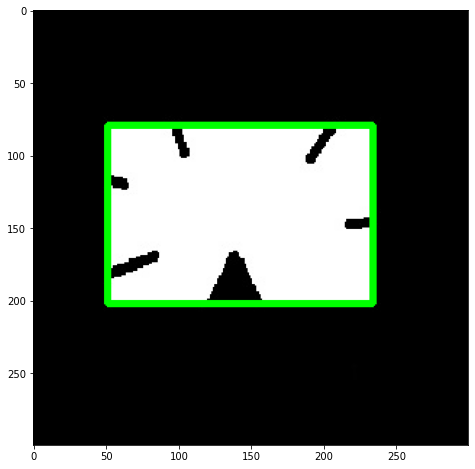

In [25]:
# approximation
cnt = contours[6]
epsilon = 0.1*cv2.arcLength(cnt,True)
approx = cv2.approxPolyDP(cnt,epsilon,True)

# drawing contours over original image
img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.drawContours(img_with_contours, [approx], 0, (0,255,0), 3); # Talk about (0, 255, 0) colors


plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

## Contour Approximation

In [26]:
# Interactive demo - 3
# Contour approximation value

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets


sl1 = widgets.FloatSlider(value=0.00, min=0.00, max=0.04, step=0.01)

def f(scale):
    
    img = cv2.imread("imgs/imgs/chapter6/contours.jpg", 0);
    thresh = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);
    
    cnt = contours[6]
    epsilon = scale*cv2.arcLength(cnt,True)
    approx = cv2.approxPolyDP(cnt,epsilon,True)

    # drawing contours over original image
    img_with_contours = img.copy();
    img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
    cv2.drawContours(img_with_contours, [approx], 0, (0,255,0), 3); # Talk about (0, 255, 0) colors
    
    
    plt.figure(figsize=(8, 8));
    plt.imshow(img_with_contours[:,:,::-1])
    plt.show()

interact(f, scale=sl1);

interactive(children=(FloatSlider(value=0.0, description='scale', max=0.04, step=0.01), Output()), _dom_classe…

In [ ]:
# len(approx) gives the number of vertices in the approximated contour shape

In [27]:
len(approx)

4

### Convex Hull

In [28]:
print("Use slider to change slides")
# Slide section 2
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=5, min=5, max=5);

def f(slide_num):
    img_name = "imgs/imgs/chapter6/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=5, description='slide_num', max=5, min=5), Output()), _dom_classes=('wid…

In [29]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter6/contours.jpg", 0);

thresh = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);

In [30]:
# create hull array for convex hull points
hull = []
 
# calculate points for each contour
for i in range(len(contours)):
    # creating convex hull object for each contour
    hull.append(cv2.convexHull(contours[i], False))

In [31]:
# create an empty black image
drawing = np.zeros((thresh.shape[0], thresh.shape[1], 3), np.uint8)
 
# draw contours and hull points
for i in range(len(contours)):
    color_contours = (0, 255, 0) # green - color for contours
    color = (255, 0, 0) # blue - color for convex hull
    # draw ith contour
    cv2.drawContours(drawing, contours, i, color_contours, 1, 8, hierarchy)
    # draw ith convex hull object
    cv2.drawContours(drawing, hull, i, color, 1, 8)

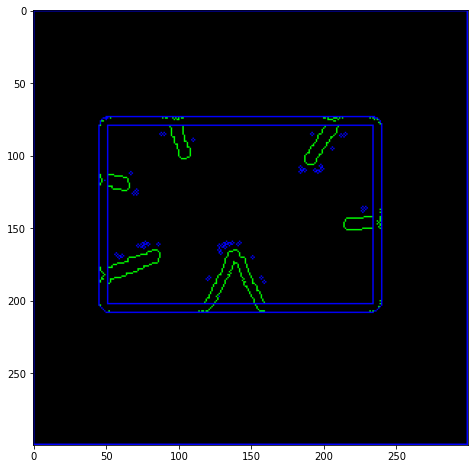

In [32]:
plt.figure(figsize=(8, 8));
plt.imshow(drawing[:,:,::-1])
plt.show()

### Bounding a contour

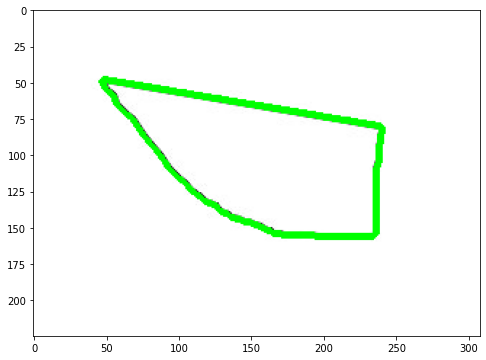

In [33]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter6/contour2.jpg", 0);



# Change thresholding and check
#ret,thresh = cv2.threshold(imgray,127,255,0)
ret,thresh = cv2.threshold(img,127,255,0)
#ret,thresh = cv2.threshold(imgray,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);


# drawing contours over original image
img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.drawContours(img_with_contours, contours, 1, (0,255,0), 3); # Talk about (0, 255, 0) colors


plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()


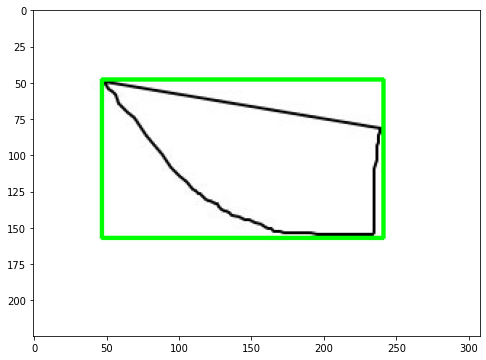

In [34]:
# Straight rectangle
cnt = contours[1]


#################FOCUS#############################
x,y,w,h = cv2.boundingRect(cnt)
###################################################






img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.rectangle(img_with_contours,(x,y),(x+w,y+h),(0,255,0),2)

plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

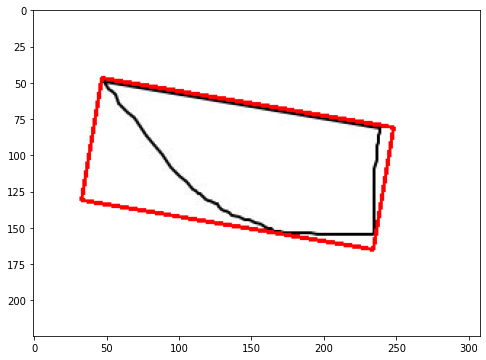

In [35]:
# Rotated rectangle

cnt = contours[1]

#######################FOCUS#########################
rect = cv2.minAreaRect(cnt)
box = cv2.boxPoints(rect)
box = np.int0(box)
#######################################################



img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.drawContours(img_with_contours,[box],0,(0,0,255),2)

plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

108


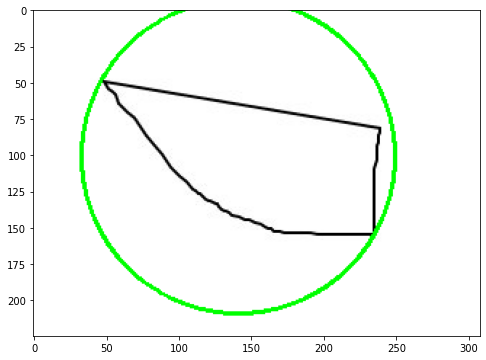

In [36]:
# Circular bounding

cnt = contours[1]

###############################FOCUS##############################
(x,y),radius = cv2.minEnclosingCircle(cnt)
center = (int(x),int(y))
radius = int(radius)
print(radius)
##################################################################




img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.circle(img_with_contours, center, radius,(0,255,0),2)

plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

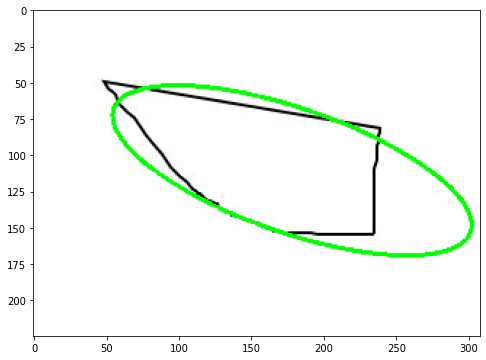

In [37]:
# Elliptical bounding

#########################FOCUS########################################
cnt = contours[1]
ellipse = cv2.fitEllipse(cnt)
######################################################################





img_with_contours = img.copy();
img_with_contours = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR);
cv2.ellipse(img_with_contours,ellipse,(0,255,0),2)

plt.figure(figsize=(8, 8));
plt.imshow(img_with_contours[:,:,::-1])
plt.show()

# Part - 1 - Topics to be covered

## [1. Image enhancement](#1)

## [2. Pillow special functions](#2)
    
## [3. OpenCV CLAHE](#3)


<a id='2'></a>
# 2. Pillow special function

In [38]:
# Interactive demo - 1
# Image sharpness Enhancer
%matplotlib inline
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
import numpy as np

sl1 = widgets.FloatSlider(value=1.0, min=1.0, max=10.0, step=1.0);

def f(factor):
    img = Image.open("imgs/imgs/chapter7/outdoor.jpg");
    
    
    #######################################FOCUS###########################
    enhancer = ImageEnhance.Sharpness(img);    
    img = enhancer.enhance(factor=factor)
    #######################################################################
    
    
    
    plt.figure(figsize=(8, 8));
    plt.imshow(img)
    plt.show()

interact(f, factor=sl1);

interactive(children=(FloatSlider(value=1.0, description='factor', max=10.0, min=1.0, step=1.0), Output()), _d…

In [39]:
# Interactive demo - 2
# Image brightness Enhancer
%matplotlib inline
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
import numpy as np

sl1 = widgets.FloatSlider(value=1.0, min=0.0, max=3.0, step=0.2);

def f(factor):
    img = Image.open("imgs/imgs/chapter7/outdoor.jpg");
    
    ##############################FOCUS####################################
    enhancer = ImageEnhance.Brightness(img);    
    img = enhancer.enhance(factor=factor)
    #######################################################################
    
    
    
    plt.figure(figsize=(10, 10));
    plt.imshow(img)
    plt.show()

interact(f, factor=sl1);

interactive(children=(FloatSlider(value=1.0, description='factor', max=3.0, step=0.2), Output()), _dom_classes…

In [40]:
# Interactive demo - 3
# Image contrast Enhancer
%matplotlib inline
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
import numpy as np

sl1 = widgets.FloatSlider(value=1.0, min=0.0, max=3.0, step=0.2);

def f(factor):
    img = Image.open("imgs/imgs/chapter7/outdoor.jpg");
    
    
    #################################FOCUS###############################
    enhancer = ImageEnhance.Contrast(img);    
    img = enhancer.enhance(factor=factor)
    #####################################################################
    
    
    plt.figure(figsize=(10, 10));
    plt.imshow(img)
    plt.show()

interact(f, factor=sl1);

interactive(children=(FloatSlider(value=1.0, description='factor', max=3.0, step=0.2), Output()), _dom_classes…

In [41]:
# Interactive demo - 4
# Image color Enhancer
%matplotlib inline
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
import numpy as np

sl1 = widgets.FloatSlider(value=1.0, min=0.0, max=3.0, step=0.2);

def f(factor):
    img = Image.open("imgs/imgs/chapter7/outdoor.jpg");
    
    
    ###############################FOCUS#############################
    enhancer = ImageEnhance.Color(img);    
    img = enhancer.enhance(factor=factor)
    #################################################################
    
    
    plt.figure(figsize=(10, 10));
    plt.imshow(img)
    plt.show()

interact(f, factor=sl1);

interactive(children=(FloatSlider(value=1.0, description='factor', max=3.0, step=0.2), Output()), _dom_classes…

## QUIZ - 1:

 - In HSV color space, which channel is responsible for strength or depth of color?

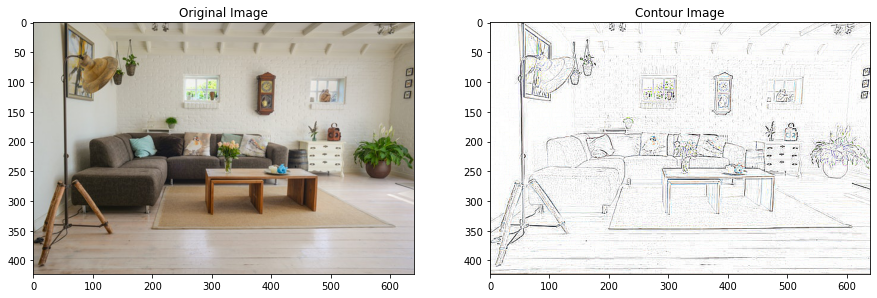

In [42]:
# Contour detection

%matplotlib inline
import numpy as np
from PIL import Image, ImageFilter
from matplotlib import pyplot as plt
img = Image.open("imgs/imgs/chapter7/indoor.jpg");


###########################FOCUS############################
contour = img.filter(ImageFilter.CONTOUR);
############################################################



f = plt.figure(figsize=(15,15))
f.add_subplot(1, 2, 1).set_title('Original Image');
plt.imshow(img)
f.add_subplot(1, 2, 2).set_title('Contour Image');
plt.imshow(contour);
plt.show()

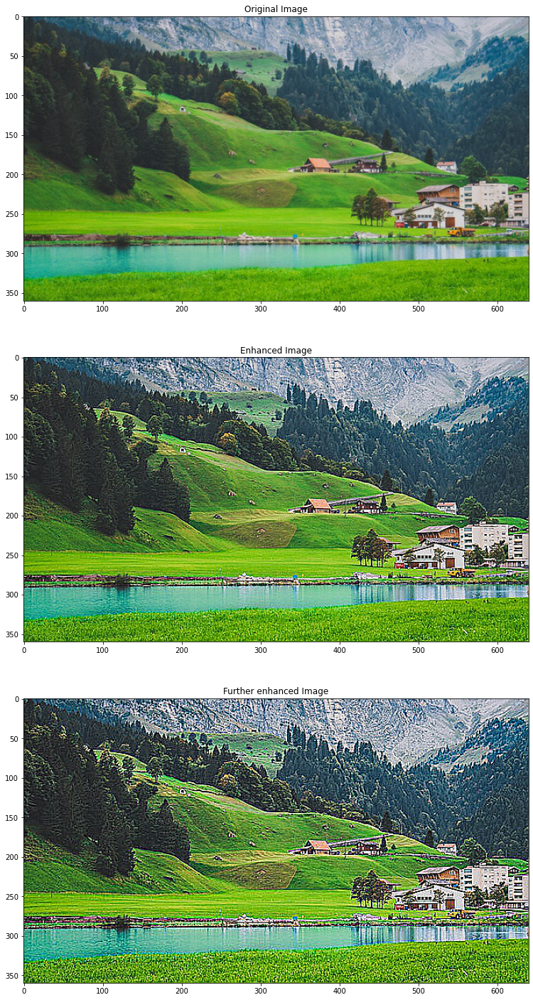

In [43]:
# Detail edge enhacement

%matplotlib inline
import numpy as np
from PIL import Image, ImageFilter
from matplotlib import pyplot as plt
img = Image.open("imgs/imgs/chapter7/outdoor.jpg");


#######################################FOCUS############################################
output1 = img.filter(ImageFilter.EDGE_ENHANCE);
output2 = img.filter(ImageFilter.EDGE_ENHANCE_MORE);
########################################################################################



f = plt.figure(figsize=(15,25))
f.add_subplot(3, 1, 1).set_title('Original Image');
plt.imshow(img)
f.add_subplot(3, 1, 2).set_title('Enhanced Image');
plt.imshow(output1);
f.add_subplot(3, 1, 3).set_title('Further enhanced Image');
plt.imshow(output2);
plt.show()

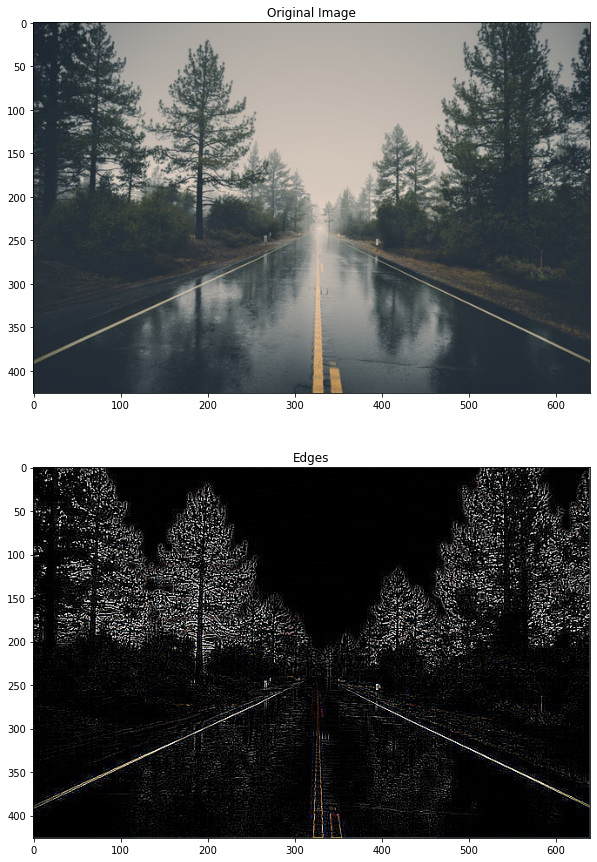

In [44]:
# Edge Detection

%matplotlib inline
import numpy as np
from PIL import Image, ImageFilter
from matplotlib import pyplot as plt
img = Image.open("imgs/imgs/chapter7/rain.jpg");




####################################FOCUS###############################
output = img.filter(ImageFilter.FIND_EDGES);
########################################################################




f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img)
f.add_subplot(2, 1, 2).set_title('Edges');
plt.imshow(output);
plt.show()

<a id='2'></a>
# OpenCV CLAHE
    - Contrast limited adaptive histogram equalization

## Quiz 2
 - Code as per the instructions

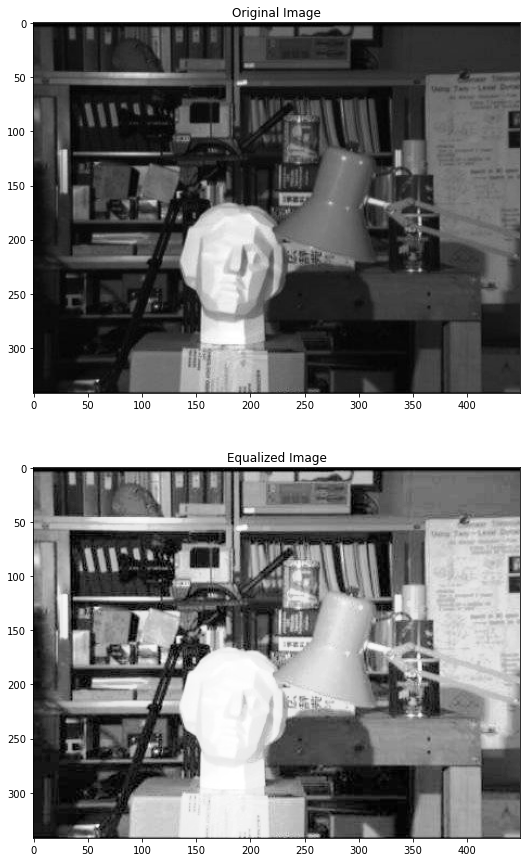

In [45]:
# General histogram equalization usin OpenCV

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter7/hist_eq.jpg", 0);


# Ue OpenCV's general histogram equalization function
equ = cv2.equalizeHist(img)



f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Equalized Image');
plt.imshow(equ, cmap="gray");
plt.show()

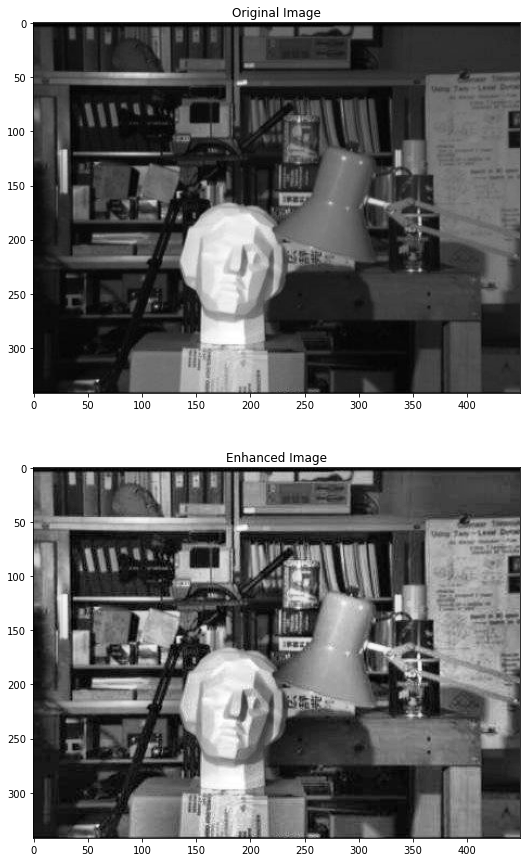

In [46]:
# CLAHE Histogram equalization

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter7/hist_eq.jpg", 0);



#################################FOCUS###########################
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
out = clahe.apply(img)
#################################################################





f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Enhanced Image');
plt.imshow(out, cmap="gray");
plt.show()


In [47]:
# Interactive demo - 5
# Understanding the effect of tile grid size and clip limit in clahe enhancement on each channel of image

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import cv2
import numpy as np

sl1 = widgets.IntSlider(value=1, min=1, max=15, step=1);
sl2 = widgets.FloatSlider(value=2.0, min=2.0, max=40.0, step=5.0);

def f(grid, limit):
    img = cv2.imread("imgs/imgs/chapter7/outdoor.jpg", 1);
    
    b, g, r = cv2.split(img);
    
    clahe = cv2.createCLAHE(clipLimit=limit, tileGridSize=(grid, grid))
    
    
    b = clahe.apply(b)
    #g = clahe.apply(g)
    #r = clahe.apply(r)
    
    out = cv2.merge((b, g, r))
    
    

    plt.figure(figsize=(10, 10))
    plt.imshow(out[:,:,::-1])
    plt.show()

interact(f, grid=sl1, limit=sl2);

interactive(children=(IntSlider(value=1, description='grid', max=15, min=1), FloatSlider(value=2.0, descriptio…

# Part - 3 - Topics to be covered


## [1. Multi-scale image processing](#1)
        - What is it
        - Need for it (object detection)
        

## [2. Image pyramids](#2)
        - What are they
        - Where are they used
        
   
## [3. Image pyramids using OpenCV](#3)


## [4. Image blending using Pyramids](#4)


## [5. Image compression](#5)

<a id='1'></a>
# Multi-scale Image processing

In [48]:
# Slide section 1
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=1, min=1, max=7);

def f(slide_num):
    img_name = "imgs/imgs/chapter8/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=1, description='slide_num', max=7, min=1), Output()), _dom_classes=('wid…

<a id='2'></a>
# Image pyramids using OpenCV

In [49]:
# Lower pyramids using OpenCV

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter8/indoor.jpg", 0);

print("Original Image shape            - {}".format(img.shape))

Original Image shape            - (423, 640)


In [50]:
lower_reso1 = cv2.pyrDown(img)
print("First Lower Pyramid Image shape - {}".format(lower_reso1.shape))

First Lower Pyramid Image shape - (212, 320)


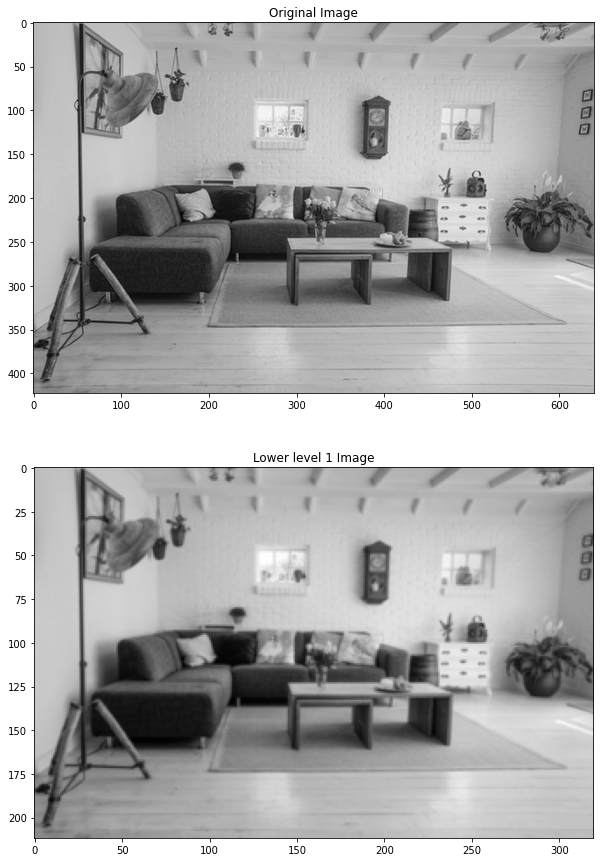

In [51]:
f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Lower level 1 Image');
plt.imshow(lower_reso1, cmap="gray");
plt.show()

#Look at the scale next to the image, not the visible shape

### Resizing is the result of kernel stride 
 - Visualize - https://jhui.github.io/2017/03/16/CNN-Convolutional-neural-network/

Original Image shape            - (423, 640)
First Lower Pyramid Image shape - (212, 320)
 Restored Image shape           - (424, 640)


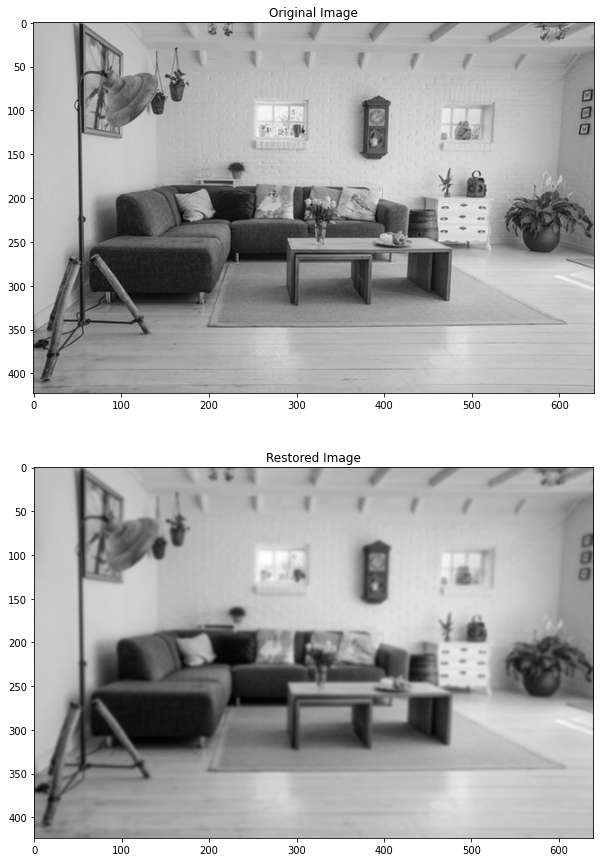

In [52]:
# Higher pyramids using OpenCV

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter8/indoor.jpg", 0);

print("Original Image shape            - {}".format(img.shape))

lower_reso1 = cv2.pyrDown(img)
print("First Lower Pyramid Image shape - {}".format(lower_reso1.shape))

restored_reso = cv2.pyrUp(lower_reso1)
print(" Restored Image shape           - {}".format(restored_reso.shape))

f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Restored Image');
plt.imshow(restored_reso, cmap="gray");
plt.show()

In [53]:
# Gaussian Pyramid downscaling

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
A = cv2.imread("imgs/imgs/chapter8/sea.jpg", 1);
height, width, channel = A.shape;

gaussian_pyramid = [];

# First image in pyramid is the orginal one
gaussian_pyramid.append(A);


# Then for six times we apply pyramid down functions
for i in range(5):
    A = cv2.pyrDown(A)
    B = np.zeros((height, width, 3), dtype=np.uint8)
    B[:A.shape[0], :A.shape[1], :] = A[:, :, :]
    gaussian_pyramid.append(B)



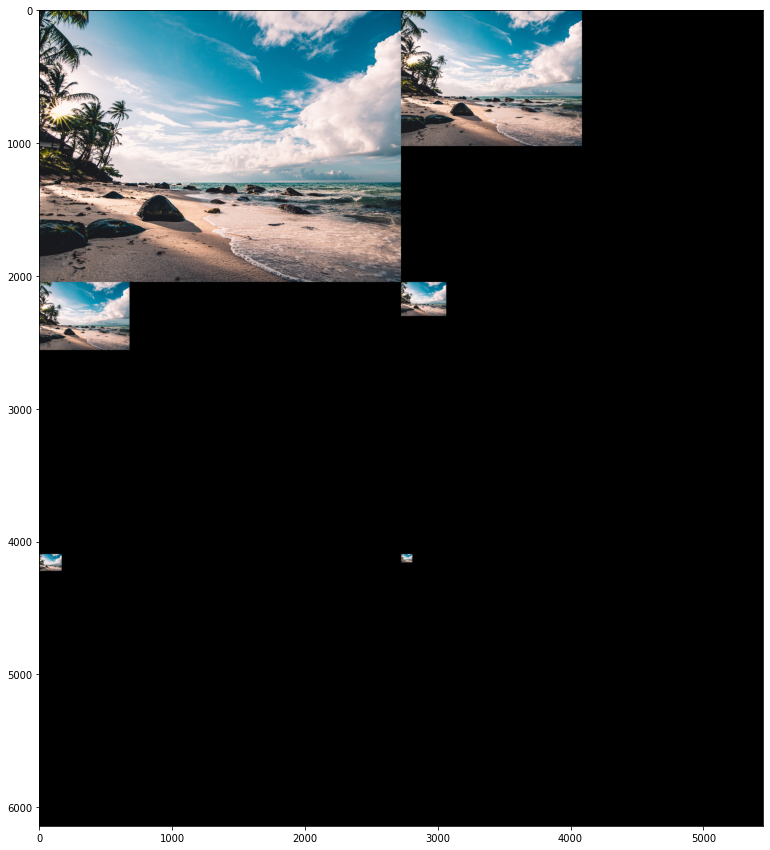

In [54]:
img1 = np.hstack((gaussian_pyramid[0], gaussian_pyramid[1]))
img2 = np.hstack((gaussian_pyramid[2], gaussian_pyramid[3]))
img3 = np.hstack((gaussian_pyramid[4], gaussian_pyramid[5]))

out = np.vstack((img1, img2, img3))

plt.figure(figsize=(15, 15))
plt.imshow(out[:,:,::-1])
plt.show()

(360, 640, 3) (360, 640, 3)


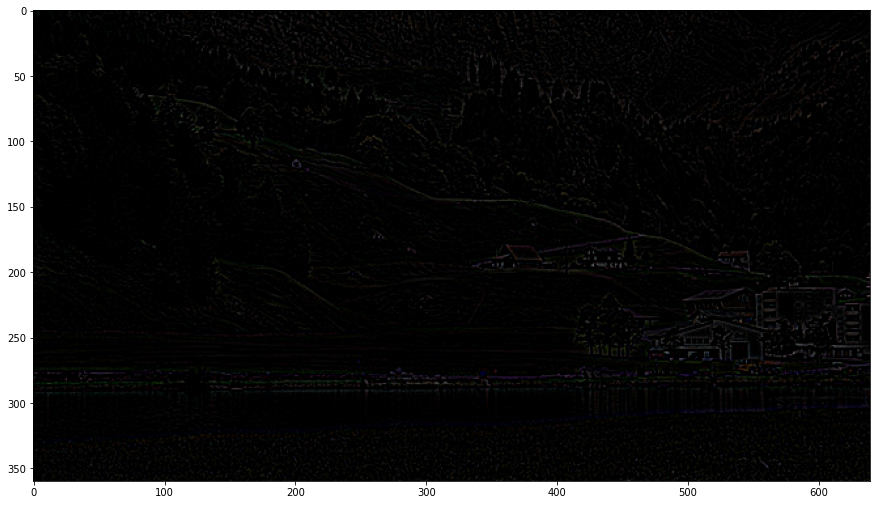

In [55]:
# Laplacian Pyramid upscaling

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
A = cv2.imread("imgs/imgs/chapter8/outdoor.jpg", 1);


down = cv2.pyrDown(A);
up = cv2.pyrUp(down);

print(A.shape, up.shape)
laplacian_up = cv2.subtract(A, up);

plt.figure(figsize=(15, 15))
plt.imshow(laplacian_up[:,:,::-1])
plt.show()

<a id='3'></a>
# Image blending using Pyramids
    - Continuous integration of images


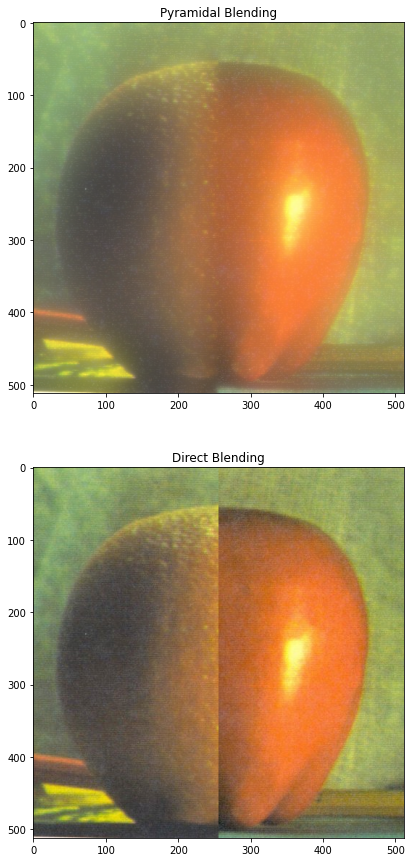

In [56]:
# Image credits: https://github.com/opencv/opencv/tree/master/samples/data

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
A = cv2.imread("imgs/imgs/chapter8/orange.jpg", 1);
B = cv2.imread("imgs/imgs/chapter8/apple.jpg", 1);


# generate Gaussian pyramid for A
G = A.copy()
gpA = [G]
for i in range(6):
    G = cv2.pyrDown(G)
    gpA.append(G)
    

# generate Gaussian pyramid for B
G = B.copy()
gpB = [G]
for i in range(6):
    G = cv2.pyrDown(G)
    gpB.append(G)


# generate Laplacian Pyramid for A
lpA = [gpA[5]]
for i in range(5,0,-1):
    GE = cv2.pyrUp(gpA[i])
    L = cv2.subtract(gpA[i-1],GE)
    lpA.append(L)
    
# generate Laplacian Pyramid for B
lpB = [gpB[5]]
for i in range(5,0,-1):
    GE = cv2.pyrUp(gpB[i])
    L = cv2.subtract(gpB[i-1],GE)
    lpB.append(L)
    

#Now add left and right halves of images in each level
LS = []
for la,lb in list(zip(lpA,lpB)):
    rows,cols,dpt = la.shape
    ls = np.hstack((la[:,0:cols//2], lb[:,cols//2:]))
    LS.append(ls)

# now reconstruct
ls_ = LS[0]
for i in range(1,6):
    ls_ = cv2.pyrUp(ls_)
    ls_ = cv2.add(ls_, LS[i])

# image with direct connecting each half
real = np.hstack((A[:,:cols//2],B[:,cols//2:]))
#cv2.imwrite('Pyramid_blending2.jpg',ls_)
#cv2.imwrite('Direct_blending.jpg',real)   

f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Pyramidal Blending');
plt.imshow(ls_[:, :,::-1])
f.add_subplot(2, 1, 2).set_title('Direct Blending');
plt.imshow(real[:, :,::-1]);
plt.show()

<a id='4'></a>
# Image compression

In [57]:
print("Use slider to change slides")
# Slide section 2
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=8, min=8, max=9);

def f(slide_num):
    img_name = "imgs/imgs/chapter8/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=8, description='slide_num', max=9, min=8), Output()), _dom_classes=('wid…

### Run length encoding example

 - 1 row image
 - Input: 255; 255; 255..... for 10 colums; 0..... for 15 columns; 128.....100 columns; 255.... 5 colums;
 - Output: 255 10; 0 15; 128 100; 255 5

# Part - 3 - Topics to cover


## [1. Image features](#1)
        1. What constitutes a feature
        2. Edges, contours, corners, colors, and blobs as features
        2. The use of features
        3. Invariance in features
            1. scale
            2. rotation
            3. translation
            4. perspective
            5. affine
            6. color


## [2. Corners as features](#2)
        - 1. What are corners
        - 2. What is their importance
        - 3. Need and applications
        - 4. Harris corner
        - 5. Shi-tomasi corner detection
        - 6. Fast Corner detection OpenCV
        
    
## [3. Feature extraction and visualization using OpenCV and PIL](#3)
        - 1. Level A features
            - Hog features
            - Daisy features
            - GLCM features
            - Haar features
            - LBP features
            - Orientations of corners
            - Blob features
        - 2. Level B Features
            - SIFT features
            - CENSURE features
            - SURF features
            - BRIEF features
            - BRISK features
            - KAZE features
            - AKAZE features
            - ORB features
        
## [4. Feature matching](#4)
        - 1. What is feature Matching
        - 2. Applications of feature matching
        - 3. Feature Matching using OpenCV
        - 4. What are the elements of feature matcher object in OpenCV
        - 5. What is RANSAC
        - 6. Flann based matcher
        - 7. Homography
            - What is homography?
            - Using homography for feature matching
    
    
    
## [5. Image stitching](#5)
        - What is image stitching
        - Applications of image stitching
        - Panaroma creations and image stitching
        - Image Stitching using OpenCV



<a id='1'></a>
# Image Features

In [58]:
print("Use slider to change slides")
# Slide section 1
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=1, min=1, max=7);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=1, description='slide_num', max=7, min=1), Output()), _dom_classes=('wid…

<a id='2'></a>
# Corners as features

In [59]:
print("Use slider to change slides")
# Slide section 2
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=8, min=8, max=12);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);
 

Use slider to change slides


interactive(children=(IntSlider(value=8, description='slide_num', max=12, min=8), Output()), _dom_classes=('wi…

## Harris Corner detection using OpenCV

In [60]:
print("Use slider to change slides")
# Slide section 3
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=13, min=13, max=13);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=13, description='slide_num', max=13, min=13), Output()), _dom_classes=('…

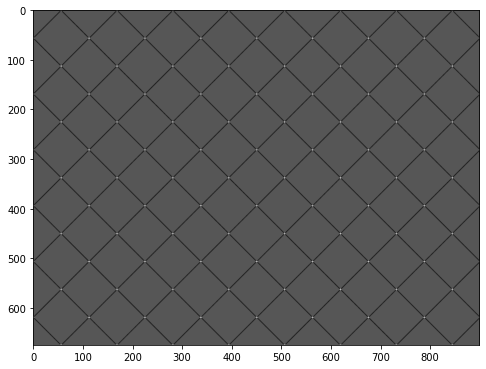

In [61]:
##Harris Corners using OpenCV
    
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/chess_slant.jpg", 1);
#img = cv2.resize(img, (96, 96));

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

gray = np.float32(gray)


################################FOCUS#######################################
dst = cv2.cornerHarris(gray,2,3,0.04)
############################################################################
# Self-study: Parameters


plt.figure(figsize=(8, 8))
plt.imshow(dst, cmap="gray");
plt.show()


In [62]:
#result is dilated for marking the corners, not important
dst = cv2.dilate(dst,None)

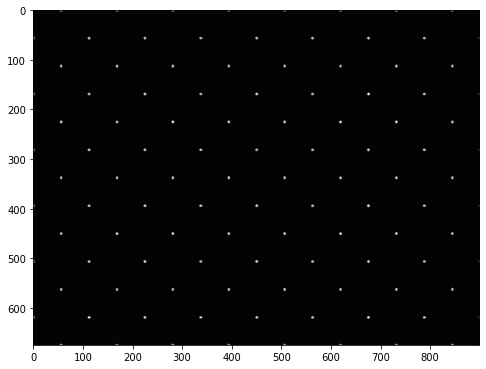

In [63]:
plt.figure(figsize=(8, 8))
plt.imshow(dst, cmap="gray");
plt.show()

In [64]:
# Threshold for an optimal value, it may vary depending on the image.

# We first calculate what is the maximum and minimum value of pixel in this image
max_val = np.uint8(dst).max();
min_val = np.uint8(dst).min();

print("max_val = {}".format(max_val));
print("min_val = {}".format(min_val));

max_val = 255
min_val = 0


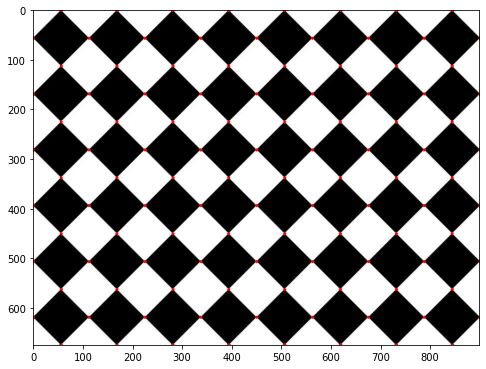

In [65]:
img = cv2.imread("imgs/imgs/chapter9/chess_slant.jpg", 1);
img[dst>0.1*dst.max()]=[0,0,255]

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

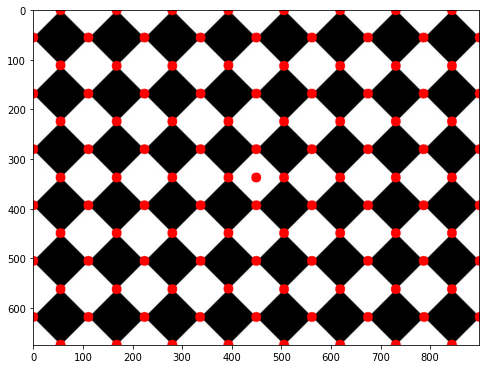

In [66]:
# Finding the coordinates of corners using opencv harris corner

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/chess_slant.jpg", 1);
#img = cv2.resize(img, (96, 96));
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# find Harris corners
gray = np.float32(gray)
dst = cv2.cornerHarris(gray,2,3,0.04)
dst = cv2.dilate(dst,None)
ret, dst = cv2.threshold(dst,0.01*dst.max(),255,0)
dst = np.uint8(dst)

# find centroids
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst)

# define the criteria to stop and refine the corners
# Explain Criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners = cv2.cornerSubPix(gray,np.float32(centroids),(5,5),(-1,-1),criteria)

# Now draw them
res = np.hstack((centroids,corners))
res = np.int0(res)

for x1, y1, x2, y2 in res:
    #cv2.circle(img,(x1, y1), 5, (0,255,0), -1) # Point Centroids
    cv2.circle(img,(x2, y2), 10, (0,0,255), -1) # Point corners

#img[res[:,1],res[:,0]]=[0,0,255]
#img[res[:,3],res[:,2]] = [0,255,0]

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

In [67]:
# Interactive demo - 1
# Understanding the effect of thresholding in harris corner detection

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import cv2
import numpy as np
from matplotlib import pyplot as plt

lst = [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000005]
sl1 = widgets.SelectionSlider(value=0.01, options=lst);

def f(threshold):
    img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
    #img = cv2.resize(img, (96, 96));
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # find Harris corners
    gray = np.float32(gray)
    dst = cv2.cornerHarris(gray,2,3,0.04)
    dst = cv2.dilate(dst,None)
    ret, dst = cv2.threshold(dst,threshold*dst.max(),255,0)
    dst = np.uint8(dst)

    # find centroids
    ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst)

    # define the criteria to stop and refine the corners
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
    corners = cv2.cornerSubPix(gray,np.float32(centroids),(5,5),(-1,-1),criteria)

    # Now draw them
    res = np.hstack((centroids,corners))
    res = np.int0(res)

    for x1, y1, x2, y2 in res:
        #cv2.circle(img,(x1, y1), 5, (0,255,0), -1) # Point Centroids
        cv2.circle(img,(x2, y2), 8, (0,0,255), -1) # Point corners

    plt.figure(figsize=(10, 10))
    plt.imshow(img[:,:,::-1])
    plt.show()

interact(f, threshold=sl1);

interactive(children=(SelectionSlider(description='threshold', index=1, options=(0.1, 0.01, 0.001, 0.0001, 1e-…

## Shi Tomasi Corner detection using OpenCV

In [68]:
print("Use slider to change slides")
# Slide section 4
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=14, min=14, max=14);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=14, description='slide_num', max=14, min=14), Output()), _dom_classes=('…

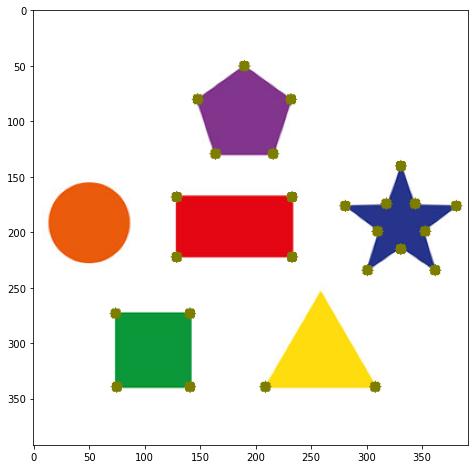

In [69]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/shape.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

################################FOCUS################################
corners = cv2.goodFeaturesToTrack(gray,25,0.01,10)
# Self-study: Parameters
corners = np.int0(corners)
#####################################################################

################################FOCUS################################
for i in corners:
    x,y = i.ravel()
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)
#####################################################################    
    

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

## Shi-Tomasi Corners

In [70]:
# Interactive demo - 2
# Understanding the effect of best-n corners and min_distance in shi-tomasi corners

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
import cv2
import numpy as np

sl1 = widgets.IntSlider(value=30, min=10, max=200, step=10);
sl2 = widgets.IntSlider(value=10, min=0, max=100, step=5);

def f(best, min_distance):
    img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    corners = cv2.goodFeaturesToTrack(gray, best, 0.01, min_distance)
    corners = np.int0(corners)

    for i in corners:
        x,y = i.ravel()
        cv2.circle(img,(x,y), 5,(0, 0, 255),-1)

    plt.figure(figsize=(10, 10))
    plt.imshow(img[:,:,::-1])
    plt.show()

interact(f, best=sl1, min_distance = sl2);

interactive(children=(IntSlider(value=30, description='best', max=200, min=10, step=10), IntSlider(value=10, d…

## OpenCV Fast Corners

In [71]:
print("Use slider to change slides")
# Slide section 5
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=15, min=15, max=15);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=15, description='slide_num', max=15, min=15), Output()), _dom_classes=('…

Threshold:  10
nonmaxSuppression:  True
neighborhood:  2
Total Keypoints with nonmaxSuppression:  2870
Total Keypoints without nonmaxSuppression:  11533


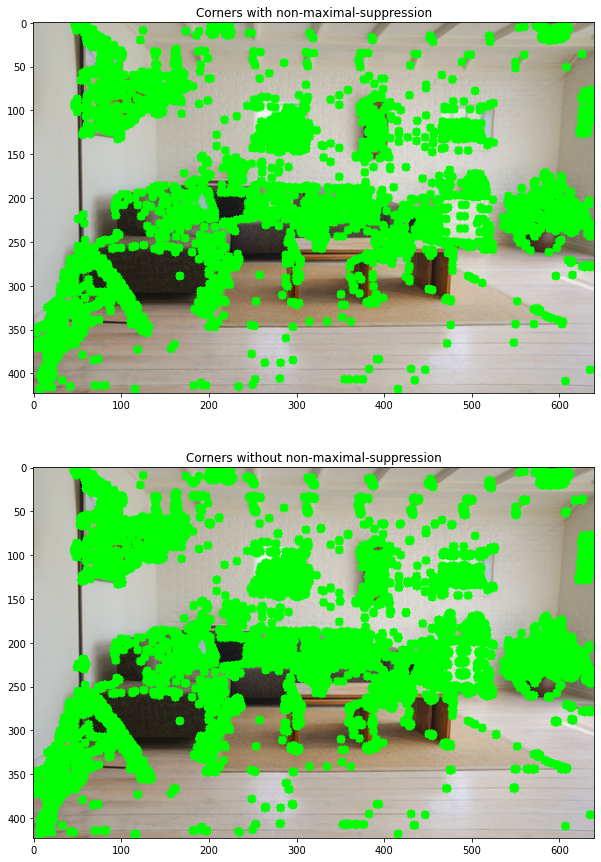

In [72]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

img = cv2.imread('imgs/imgs/chapter9/indoor.jpg',1)
img2 = img.copy();
img3 = img.copy();






###############################FOCUS####################################
# Initiate FAST object with default values
fast = cv2.FastFeatureDetector_create()

# find and draw the keypoints
kp = fast.detect(img,None)
########################################################################














for i in kp:
    x,y = int(i.pt[0]), int(i.pt[1]);
    cv2.circle(img2,(x,y), 5,(0, 255, 0),-1)

# Print all default params
print ("Threshold: ", fast.getThreshold())
print ("nonmaxSuppression: ", fast.getNonmaxSuppression())
print ("neighborhood: ", fast.getType())
print ("Total Keypoints with nonmaxSuppression: ", len(kp))


# Disable nonmaxSuppression
fast.setNonmaxSuppression(0)
kp = fast.detect(img,None)

print ("Total Keypoints without nonmaxSuppression: ", len(kp))

for i in kp:
    x,y = int(i.pt[0]), int(i.pt[1]);
    cv2.circle(img3,(x,y), 5,(0, 255, 0),-1)


f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Corners with non-maximal-suppression');
plt.imshow(img2[:, :,::-1])
f.add_subplot(2, 1, 2).set_title('Corners without non-maximal-suppression');
plt.imshow(img3[:, :,::-1]);
plt.show()

In [73]:
# Timing harris corners, shi-tomasi corners, and fast corners in opencv
import numpy as np
import cv2
from matplotlib import pyplot as plt

def harris_corner(img):
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # find Harris corners
    gray = np.float32(gray)
    dst = cv2.cornerHarris(gray,2,3,0.04)
    dst = cv2.dilate(dst,None)
    ret, dst = cv2.threshold(dst,0.0001*dst.max(),255,0)
    dst = np.uint8(dst)

    # find centroids
    ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst)

    # define the criteria to stop and refine the corners
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
    corners = cv2.cornerSubPix(gray,np.float32(centroids),(5,5),(-1,-1),criteria)
    
def shi_tomasi_corner(img):
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    corners = cv2.goodFeaturesToTrack(gray, 100, 0.01, 10)
    corners = np.int0(corners)
    
def fast_corner(img):
    fast = cv2.FastFeatureDetector_create()
    kp = fast.detect(img,None)


In [74]:
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

In [75]:
%timeit harris_corner(img);

100 loops, best of 5: 15.1 ms per loop


In [76]:
%timeit shi_tomasi_corner(img);

100 loops, best of 5: 9.42 ms per loop


In [77]:
%timeit fast_corner(img);

1000 loops, best of 5: 1.75 ms per loop


<a id='3'></a>
# Different features in Image Processing

### Hog Features

In [78]:
print("Use slider to change slides")
# Slide section 6
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=16, min=16, max=16);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=16, description='slide_num', max=16, min=16), Output()), _dom_classes=('…

### Implementing Hog features using Skimage

(322218,)


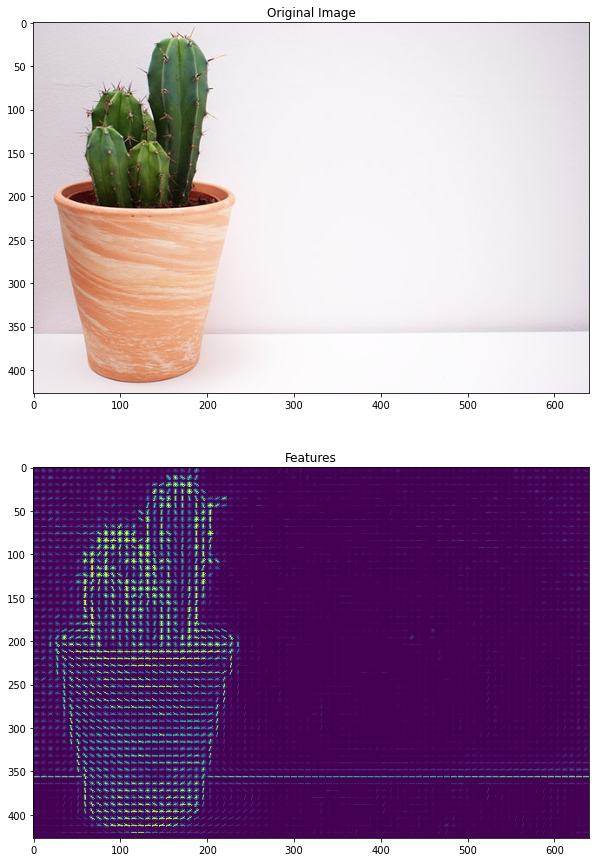

In [79]:
%matplotlib inline
import numpy as np
import skimage
import skimage.feature
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/plant.jpg", 1);

features, output = skimage.feature.hog(img, orientations=9, pixels_per_cell=(8, 8), 
                    cells_per_block=(3, 3), block_norm='L2-Hys', 
                    visualize=True, transform_sqrt=False, feature_vector=True, multichannel=None)

print(features.shape);

# Rescale histogram for better display
output = skimage.exposure.rescale_intensity(output, in_range=(0, 10))


f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img[:, :,::-1])
f.add_subplot(2, 1, 2).set_title('Features');
plt.imshow(output);
plt.show()

### Daisy Features

In [80]:
print("Use slider to change slides")
# Slide section 7
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=17, min=17, max=17);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=17, description='slide_num', max=17, min=17), Output()), _dom_classes=('…

#### 3.1.2.2. Implementing Daisy features using Skimage

(2, 3, 153)


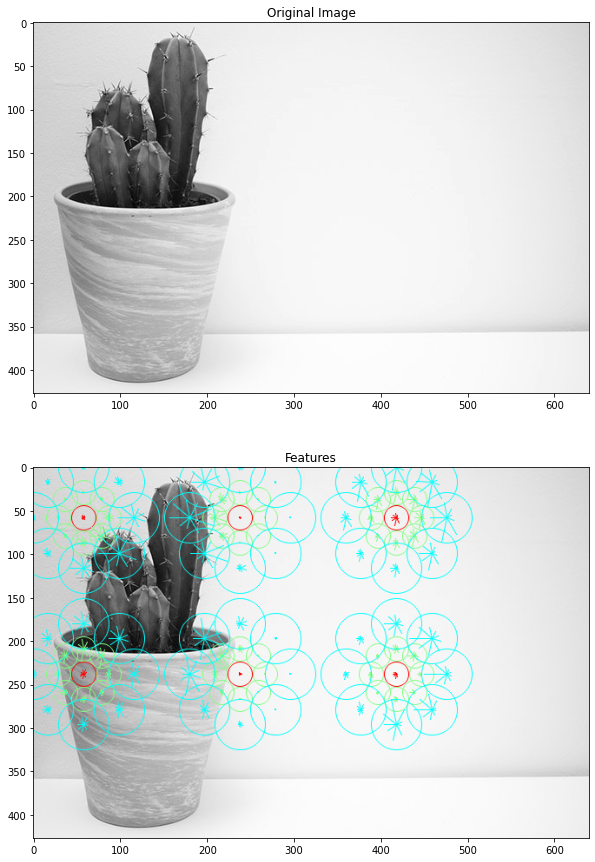

In [81]:
%matplotlib inline
import numpy as np
import skimage
import skimage.feature
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/plant.jpg", 0);
#img = cv2.resize(img, (img.shape[0]//4,img.shape[1]//4));

features, output = skimage.feature.daisy(img, step=180, radius=58, rings=2, histograms=8, 
                                         orientations=9, visualize=True)
print(features.shape);

# Rescale histogram for better display
#output = skimage.exposure.rescale_intensity(output, in_range=(0, 10))


f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Features');
plt.imshow(output);
plt.show()

### GLCM Features

In [82]:
print("Use slider to change slides")
# Slide section 8
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=18, min=18, max=18);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=18, description='slide_num', max=18, min=18), Output()), _dom_classes=('…

In [ ]:
### 3.1.3.2. Implementing GLCM features using Skimage

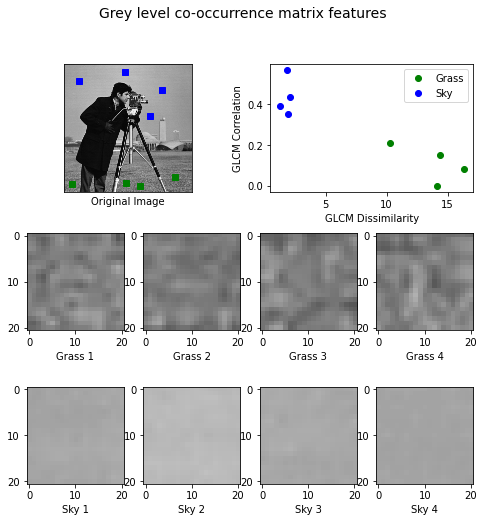

In [83]:
# Source: https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_glcm.html

import matplotlib.pyplot as plt

from skimage.feature import greycomatrix, greycoprops
from skimage import data


PATCH_SIZE = 21

# open the camera image
image = data.camera()

# select some patches from grassy areas of the image
grass_locations = [(474, 291), (440, 433), (466, 18), (462, 236)]
grass_patches = []
for loc in grass_locations:
    grass_patches.append(image[loc[0]:loc[0] + PATCH_SIZE,
                               loc[1]:loc[1] + PATCH_SIZE])

# select some patches from sky areas of the image
sky_locations = [(54, 48), (21, 233), (90, 380), (195, 330)]
sky_patches = []
for loc in sky_locations:
    sky_patches.append(image[loc[0]:loc[0] + PATCH_SIZE,
                             loc[1]:loc[1] + PATCH_SIZE])

# compute some GLCM properties each patch
xs = []
ys = []
for patch in (grass_patches + sky_patches):
    glcm = greycomatrix(patch, [5], [0], 256, symmetric=True, normed=True)
    xs.append(greycoprops(glcm, 'dissimilarity')[0, 0])
    ys.append(greycoprops(glcm, 'correlation')[0, 0])

# create the figure
fig = plt.figure(figsize=(8, 8))

# display original image with locations of patches
ax = fig.add_subplot(3, 2, 1)
ax.imshow(image, cmap=plt.cm.gray, interpolation='nearest',
          vmin=0, vmax=255)
for (y, x) in grass_locations:
    ax.plot(x + PATCH_SIZE / 2, y + PATCH_SIZE / 2, 'gs')
for (y, x) in sky_locations:
    ax.plot(x + PATCH_SIZE / 2, y + PATCH_SIZE / 2, 'bs')
ax.set_xlabel('Original Image')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('image')

# for each patch, plot (dissimilarity, correlation)
ax = fig.add_subplot(3, 2, 2)
ax.plot(xs[:len(grass_patches)], ys[:len(grass_patches)], 'go',
        label='Grass')
ax.plot(xs[len(grass_patches):], ys[len(grass_patches):], 'bo',
        label='Sky')
ax.set_xlabel('GLCM Dissimilarity')
ax.set_ylabel('GLCM Correlation')
ax.legend()

# display the image patches
for i, patch in enumerate(grass_patches):
    ax = fig.add_subplot(3, len(grass_patches), len(grass_patches)*1 + i + 1)
    ax.imshow(patch, cmap=plt.cm.gray, interpolation='nearest',
              vmin=0, vmax=255)
    ax.set_xlabel('Grass %d' % (i + 1))

for i, patch in enumerate(sky_patches):
    ax = fig.add_subplot(3, len(sky_patches), len(sky_patches)*2 + i + 1)
    ax.imshow(patch, cmap=plt.cm.gray, interpolation='nearest',
              vmin=0, vmax=255)
    ax.set_xlabel('Sky %d' % (i + 1))


# display the patches and plot
fig.suptitle('Grey level co-occurrence matrix features', fontsize=14)
plt.show()


### Haar Features

In [84]:
print("Use slider to change slides")
# Slide section 9
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=19, min=19, max=19);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=19, description='slide_num', max=19, min=19), Output()), _dom_classes=('…

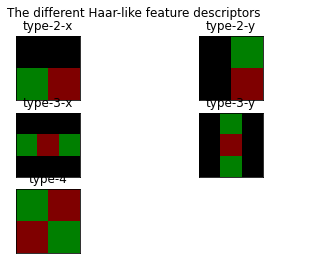

In [85]:
# Source: https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_haar.html

# Haar like feature Descriptors
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import skimage.feature
from skimage.feature import haar_like_feature_coord, draw_haar_like_feature

images = [np.zeros((2, 2)), np.zeros((2, 2)),
          np.zeros((3, 3)), np.zeros((3, 3)),
          np.zeros((2, 2))]

feature_types = ['type-2-x', 'type-2-y',
                 'type-3-x', 'type-3-y',
                 'type-4']

fig, axs = plt.subplots(3, 2)
for ax, img, feat_t in zip(np.ravel(axs), images, feature_types):
    coord, _ = haar_like_feature_coord(img.shape[0], img.shape[1], feat_t)
    haar_feature = draw_haar_like_feature(img, 0, 0,
                                          img.shape[0],
                                          img.shape[1],
                                          coord,
                                          max_n_features=1,
                                          random_state=0)
    ax.imshow(haar_feature)
    ax.set_title(feat_t)
    ax.set_xticks([])
    ax.set_yticks([])

fig.suptitle('The different Haar-like feature descriptors')
plt.axis('off')
plt.show()

### LBP Features

In [86]:
print("Use slider to change slides")
# Slide section 10
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=20, min=20, max=20);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

Use slider to change slides


interactive(children=(IntSlider(value=20, description='slide_num', max=20, min=20), Output()), _dom_classes=('…

(2, 3, 153)


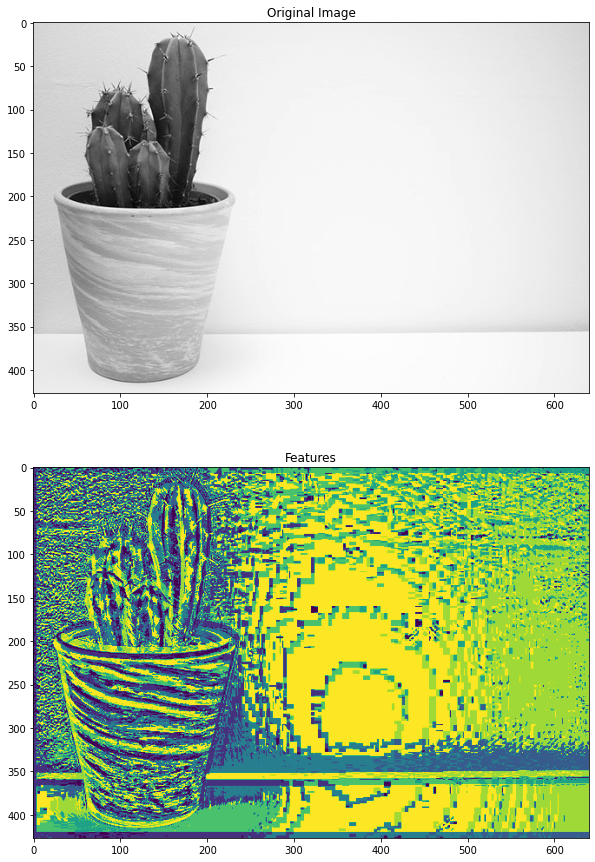

In [87]:
%matplotlib inline
import numpy as np
import skimage
import skimage.feature
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/plant.jpg", 0);
#img = cv2.resize(img, (img.shape[0]//4,img.shape[1]//4));

output = skimage.feature.local_binary_pattern(img, 3, 8, method='default')
print(features.shape);

# Rescale histogram for better display
#output = skimage.exposure.rescale_intensity(output, in_range=(0, 10))


f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
f.add_subplot(2, 1, 2).set_title('Features');
plt.imshow(output);
plt.show()

### Orientation of corners as Features

### Visualizing Orientation of corners

In [88]:
%matplotlib inline
from skimage.morphology import octagon
import numpy as np
import skimage
import skimage.feature
import cv2
from matplotlib import pyplot as plt

from skimage.feature import (corner_fast, corner_peaks,corner_orientations)
square = np.zeros((12, 12))
square[3:9, 3:9] = 1
print("Input:");
print(square.astype(int))

corners = corner_peaks(corner_fast(square, 9), min_distance=1)
print("Corners:");
print(corners);

orientations = corner_orientations(square, corners, octagon(3, 2))
print("Output:")
print(np.rad2deg(orientations))

Input:
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 1 1 1 1 1 1 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
Corners:
[[3 3]
 [3 8]
 [8 3]
 [8 8]]
Output:
[  45.  135.  -45. -135.]


### Blob Features

In [89]:
# Slide section 11
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=21, min=21, max=21);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=21, description='slide_num', max=21, min=21), Output()), _dom_classes=('…

In [ ]:
### 3.1.7.2 Blobs using Skimage

/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:125: RuntimeWarning: invalid value encountered in double_scalars
  r1 = blob1[-1] / blob2[-1]
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:126: RuntimeWarning: divide by zero encountered in true_divide
  pos1 = blob1[:ndim] / (max_sigma * root_ndim)
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:127: RuntimeWarning: divide by zero encountered in true_divide
  pos2 = blob2[:ndim] / (max_sigma * root_ndim)
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:129: RuntimeWarning: invalid value encountered in subtract
  d = np.sqrt(np.sum((pos2 - pos1)**2))


(91, 3)


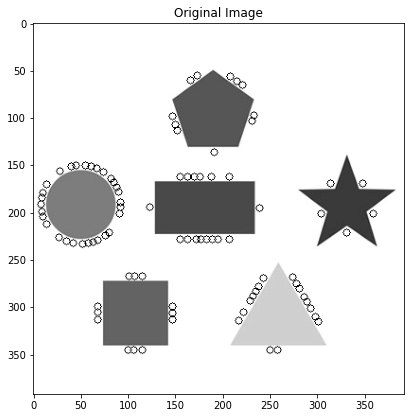

In [90]:

%matplotlib inline
import numpy as np
import skimage
import skimage.feature
import cv2
import math
from matplotlib import pyplot as plt

img = cv2.imread("imgs/imgs/chapter9/shape.jpg", 0)
#img = skimage.data.hubble_deep_field()[0:500, 0:500]
#image_gray = skimage.color.rgb2gray(image)

blobs = skimage.feature.blob_dog(img, max_sigma=5, threshold=0.05)

blobs[:, 2] = blobs[:, 2]
print(blobs.shape)

for y , x, r in blobs:
    cv2.circle(img,(int(x), int(y)), int(r), (0,255,0), 1)


f = plt.figure(figsize=(15,15))
f.add_subplot(2, 1, 1).set_title('Original Image');
plt.imshow(img, cmap="gray")
plt.show()

## Using blobs to detect deep-space galaxies

/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:125: RuntimeWarning: invalid value encountered in double_scalars
  r1 = blob1[-1] / blob2[-1]
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:126: RuntimeWarning: divide by zero encountered in true_divide
  pos1 = blob1[:ndim] / (max_sigma * root_ndim)
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:127: RuntimeWarning: divide by zero encountered in true_divide
  pos2 = blob2[:ndim] / (max_sigma * root_ndim)
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:129: RuntimeWarning: invalid value encountered in subtract
  d = np.sqrt(np.sum((pos2 - pos1)**2))


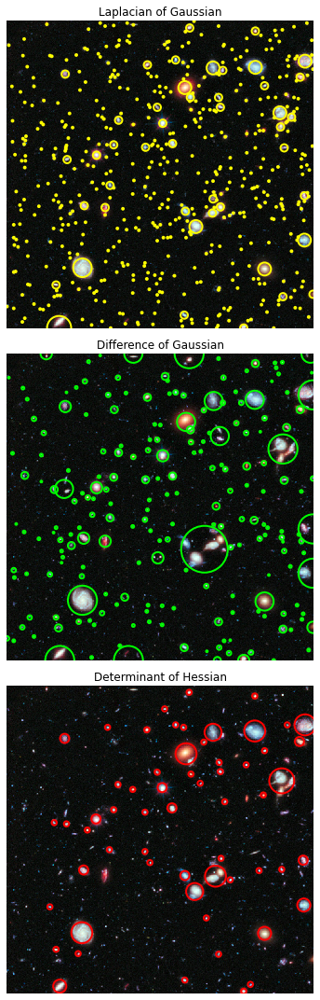

In [91]:
# Source: https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_blob.html

from math import sqrt
from skimage import data
from skimage.feature import blob_dog, blob_log, blob_doh
from skimage.color import rgb2gray

import matplotlib.pyplot as plt


image = data.hubble_deep_field()[0:500, 0:500]
image_gray = rgb2gray(image)

blobs_log = blob_log(image_gray, max_sigma=30, num_sigma=10, threshold=.1)

# Compute radii in the 3rd column.
blobs_log[:, 2] = blobs_log[:, 2] * sqrt(2)

blobs_dog = blob_dog(image_gray, max_sigma=30, threshold=.1)
blobs_dog[:, 2] = blobs_dog[:, 2] * sqrt(2)

blobs_doh = blob_doh(image_gray, max_sigma=30, threshold=.01)

blobs_list = [blobs_log, blobs_dog, blobs_doh]
colors = ['yellow', 'lime', 'red']
titles = ['Laplacian of Gaussian', 'Difference of Gaussian',
          'Determinant of Hessian']
sequence = zip(blobs_list, colors, titles)

fig, axes = plt.subplots(3, 1, figsize=(15, 15), sharex=True, sharey=True)
ax = axes.ravel()

for idx, (blobs, color, title) in enumerate(sequence):
    ax[idx].set_title(title)
    ax[idx].imshow(image, interpolation='nearest')
    for blob in blobs:
        y, x, r = blob
        c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
        ax[idx].add_patch(c)
    ax[idx].set_axis_off()

plt.tight_layout()
plt.show()

## SIFT Features

In [92]:
# Slide section 12
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=22, min=22, max=23);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=22, description='slide_num', max=23, min=22), Output()), _dom_classes=('…

### Implementing SIFT features using OpenCV

In [95]:
!pip install opencv-python==3.4.2.17
!pip install opencv-contrib-python==3.4.2.17

     |████████████████████████████████| 25.0MB 1.6MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30


     |████████████████████████████████| 30.6MB 140kB/s 
  Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30


3.4.2


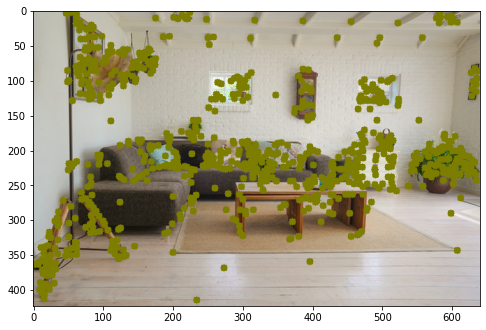

In [1]:
# NOTE: Patented work. Cannot be used for commercial purposes
#pip install opencv-contrib-python==3.4.2.16
#pip install opencv-python==3.4.2.16
%matplotlib inline
import numpy as np
import cv2
print(cv2.__version__)
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create()
keypoints, descriptors = sift.detectAndCompute(gray, None)


for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

### CENSURE Features

In [2]:
# Slide section 13
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=24, min=24, max=24);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=24, description='slide_num', max=24, min=24), Output()), _dom_classes=('…

### 3.2.2.2 Implementing CENSURE features using Skimage

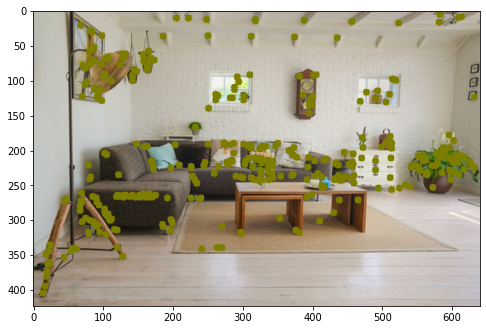

In [3]:
%matplotlib inline
import numpy as np
import cv2
import skimage.feature
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

detector = skimage.feature.CENSURE(min_scale=1, max_scale=7, mode='Star', 
                                          non_max_threshold=0.05, line_threshold=10)

detector.detect(gray)

for i in detector.keypoints:
    x,y = int(i[1]), int(i[0])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()




### SURF Features

In [4]:
# Slide section 14
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=25, min=25, max=25);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=25, description='slide_num', max=25, min=25), Output()), _dom_classes=('…

### 3.2.3.2 Implementing SURF features using OpenCV

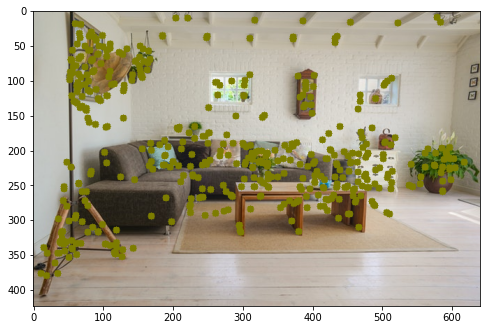

In [5]:
# NOTE: Patented work. Cannot be used for commercial purposes
# pip install opencv-contrib-python==3.4.2.16
# pip install opencv-python==3.4.2.16
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

surf = cv2.xfeatures2d.SURF_create(1000)
keypoints, descriptors = surf.detectAndCompute(gray, None)


for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

### BRIEF Features

In [6]:
# Slide section 15
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=26, min=26, max=26);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=26, description='slide_num', max=26, min=26), Output()), _dom_classes=('…

### 3.2.4.2 Implementing BRIEF features using OpenCV


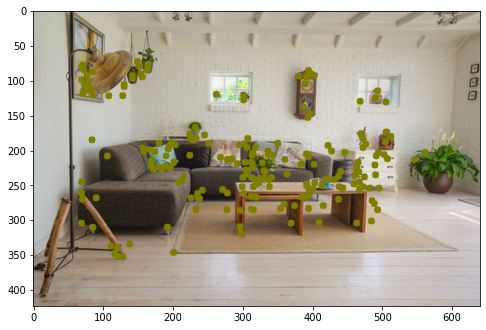

In [7]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# Initiate FAST detector
star = cv2.xfeatures2d.StarDetector_create()
kp = star.detect(gray,None)

brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
keypoints, descriptors = brief.compute(gray, kp)


for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

### BRISK Features

In [8]:
# Slide section 16
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=27, min=27, max=27);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=27, description='slide_num', max=27, min=27), Output()), _dom_classes=('…

### Implementing BRISK features using OpenCV

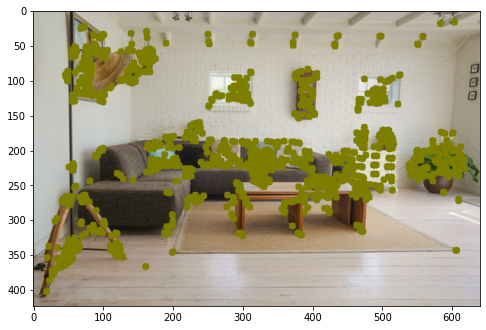

In [9]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

brisk = cv2.BRISK_create()
keypoints, descriptors = brisk.detectAndCompute(gray, None)

for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()



### KAZE and Accelerated-KAZE features
    - http://www.robesafe.com/personal/pablo.alcantarilla/kaze.html

### KAZE Features using OpenCV

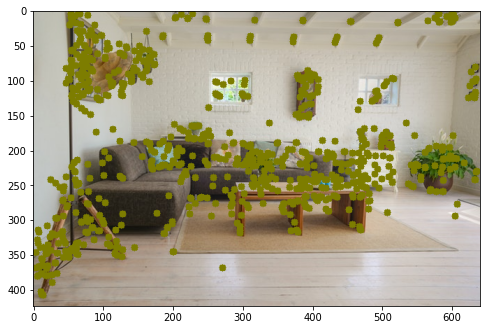

In [10]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

kaze = cv2.KAZE_create()
keypoints, descriptors = kaze.detectAndCompute(gray, None)

for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

###  AKAZE Features using OpenCV

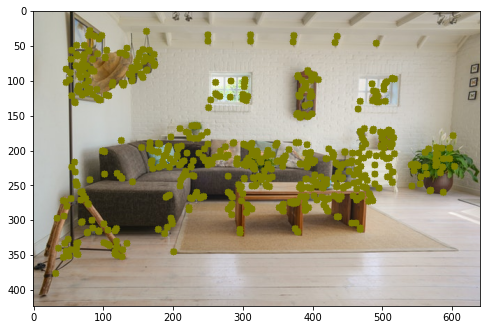

In [11]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

akaze = cv2.AKAZE_create()
keypoints, descriptors = akaze.detectAndCompute(gray, None)

for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

### ORB Features
    - Oriented Fast and Robust BRIEF Features
    - https://medium.com/@shehan.a.perera/a-comparison-of-sift-surf-and-orb-333d64bcaaea
    

### Orb Features using OpenCV

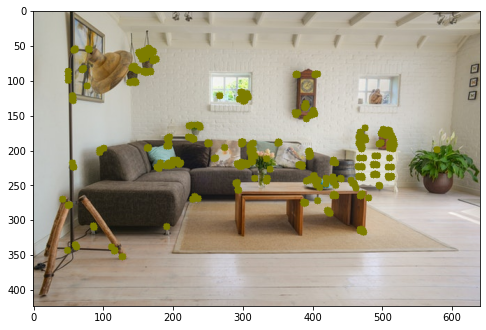

In [12]:
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);

gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

orb = cv2.ORB_create(500)
keypoints, descriptors = orb.detectAndCompute(gray, None)

for i in keypoints:
    x,y = int(i.pt[0]), int(i.pt[1])
    cv2.circle(img,(x,y), 5,(0, 125, 125),-1)

plt.figure(figsize=(8, 8))
plt.imshow(img[:,:,::-1]);
plt.show()

<a id='4'></a>
# Feature Matching

In [13]:
# Slide section 17
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=28, min=28, max=28);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=28, description='slide_num', max=28, min=28), Output()), _dom_classes=('…

### Feature Matching using OpenCV

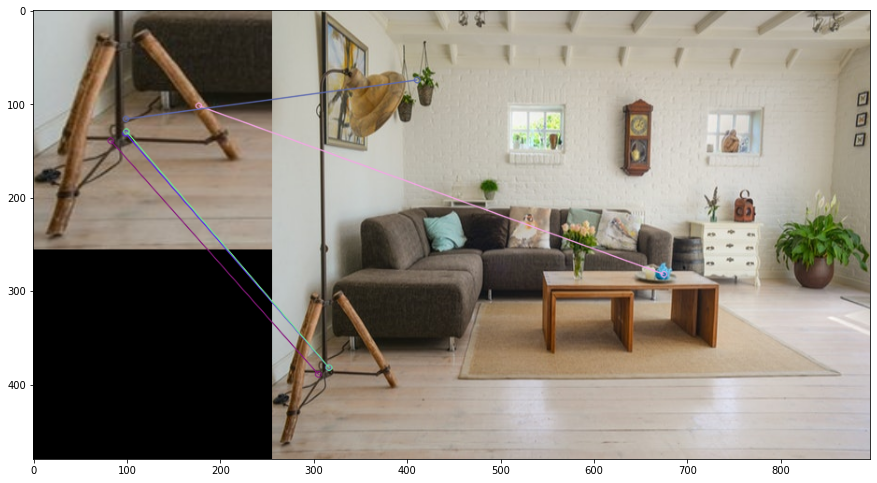

In [15]:
# Using Brute-Force matching

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt

orb = cv2.ORB_create(500)

img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = cv2.resize(img1, (256, 256));
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);

img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

# BFMatcher with default params
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1,des2,k=2)

# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

        # cv.drawMatchesKnn expects list of lists as matches.
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

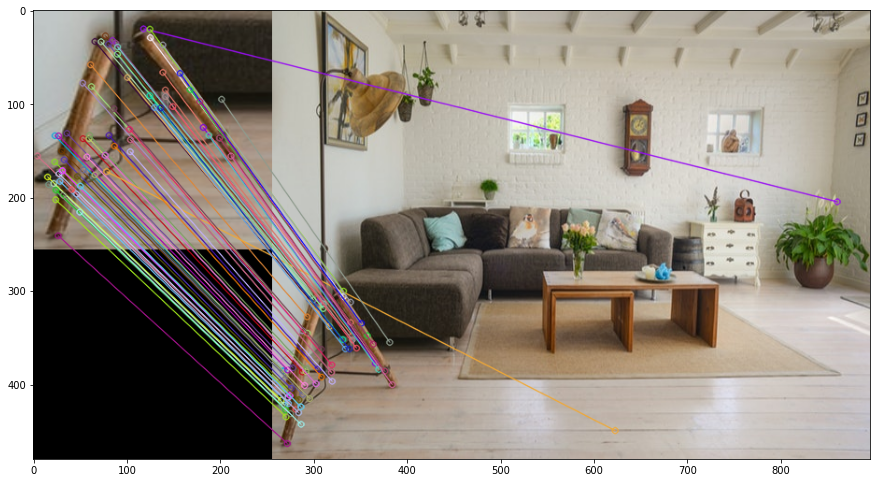

In [16]:
# Lets see how SIFT features turn out to be
# NOTE: Patented work. Cannot be used for commercial purposes
# pip install opencv-contrib-python==3.4.2.16
# pip install opencv-python==3.4.2.16
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt

sift = cv2.xfeatures2d.SIFT_create();

img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = cv2.resize(img1, (256, 256));
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);

img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

# BFMatcher with default params
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1,des2,k=2)

# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.65*n.distance:
        good.append([m])

        # cv.drawMatchesKnn expects list of lists as matches.
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

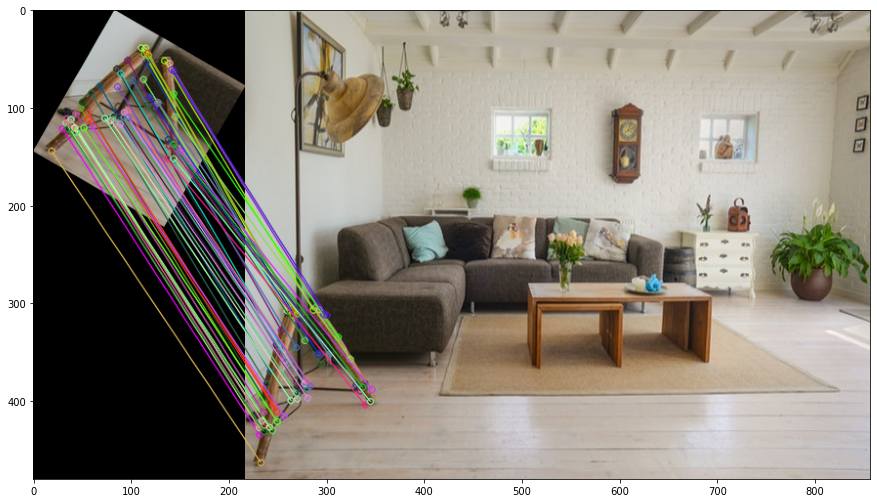

In [17]:
# Lets see how SIFT features turn out to be
# NOTE: Patented work. Cannot be used for commercial purposes
# pip install opencv-contrib-python==3.4.2.16
# pip install opencv-python==3.4.2.16
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
import imutils

sift = cv2.xfeatures2d.SIFT_create();

img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = imutils.rotate_bound(img1, 30)
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);


img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

# BFMatcher with default params
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1,des2,k=2)

# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.65*n.distance:
        good.append([m])

        # cv.drawMatchesKnn expects list of lists as matches.
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

### 4.5.2. FLann based matcher using OpenCV

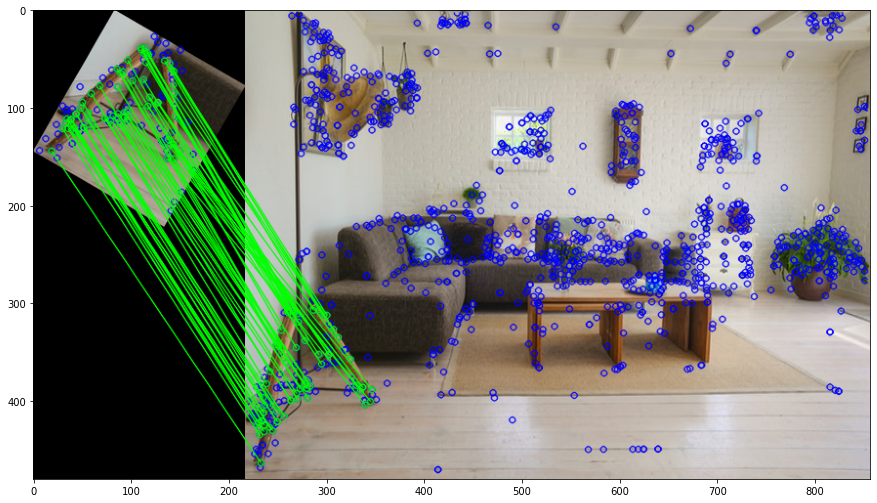

In [18]:
# Lets see how SIFT features turn out to be
# NOTE: Patented work. Cannot be used for commercial purposes
# pip install opencv-contrib-python==3.4.2.16
# pip install opencv-python==3.4.2.16
%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
import imutils

sift = cv2.xfeatures2d.SIFT_create();

img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = imutils.rotate_bound(img1, 30)
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);


img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(des1,des2,k=2)
# Need to draw only good matches, so create a mask
matchesMask = [[0,0] for i in range(len(matches))]
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,matches,None,**draw_params)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

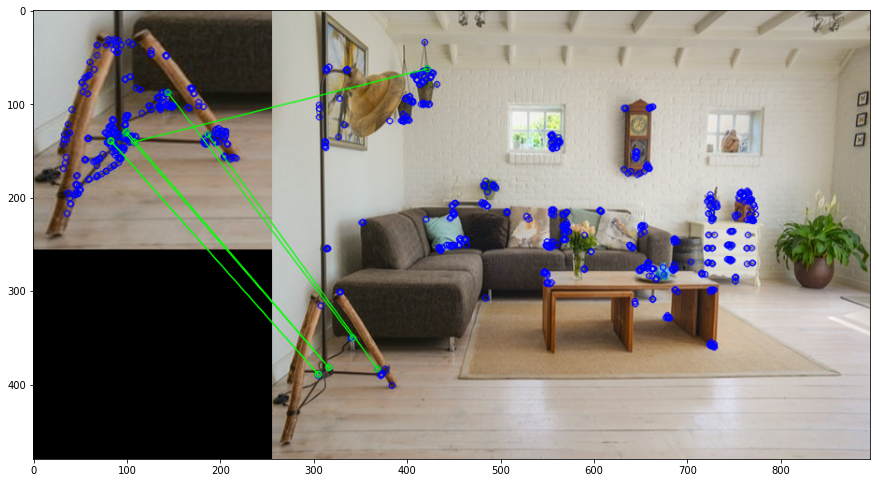

In [19]:
# Using Flann-based matching on ORB features

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
import imutils

orb = cv2.ORB_create(500)

img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = cv2.resize(img1, (256, 256));
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);

img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

# FLANN parameters
FLANN_INDEX_LSH = 6
index_params= dict(algorithm = FLANN_INDEX_LSH,
                   table_number = 6, # 12
                   key_size = 12,     # 20
                   multi_probe_level = 1) #2
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(des1,des2,k=2)
# Need to draw only good matches, so create a mask
matchesMask = [[0,0] for i in range(len(matches))]
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,matches,None,**draw_params)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

### 4.6.2. Using homography for feature matching in OpenCV
 - https://learnopencv.com/homography-examples-using-opencv-python-c/

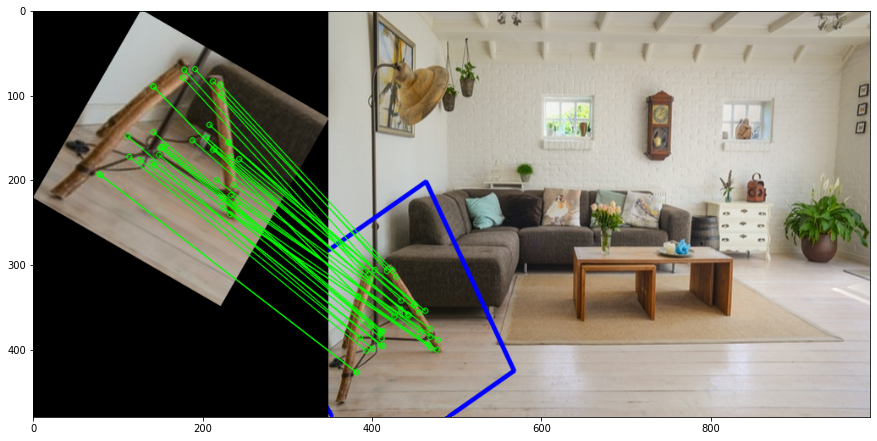

In [20]:
# Link: https://docs.opencv.org/3.4.1/d9/dab/tutorial_homography.html

%matplotlib inline
import numpy as np
import cv2
from matplotlib import pyplot as plt
img = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
import imutils
akaze = cv2.AKAZE_create()


img1 = cv2.imread("imgs/imgs/chapter9/indoor_lamp.jpg", 1);
img1 = cv2.resize(img1, (256, 256));
img1 = imutils.rotate_bound(img1, 30)
gray1 = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY);

img2 = cv2.imread("imgs/imgs/chapter9/indoor.jpg", 1);
img2 = cv2.resize(img2, (640, 480));
gray2 = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY);

# find the keypoints and descriptors with SIFT
kp1, des1 = akaze.detectAndCompute(img1,None)
kp2, des2 = akaze.detectAndCompute(img2,None)

# FLANN parameters
FLANN_INDEX_LSH = 6
index_params= dict(algorithm = FLANN_INDEX_LSH,
                   table_number = 6, # 12
                   key_size = 12,     # 20
                   multi_probe_level = 1) #2
search_params = dict(checks=50)   # or pass empty dictionary
flann = cv2.FlannBasedMatcher(index_params,search_params)

matches = flann.knnMatch(des1,des2,k=2)
# store all the good matches as per Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)
        
        
MIN_MATCH_COUNT = 10;        
# HOMOGRAPHY
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
    matchesMask = mask.ravel().tolist()
    h,w,d = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)
    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)
else:
    print( "Not enough matches are found - {}/{}".format(len(good), MIN_MATCH_COUNT) )
    matchesMask = None
    
draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)
img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)

plt.figure(figsize=(15, 15))
plt.imshow(img3[:,:,::-1]);
plt.show();

<a id='5'></a>
# Image stitching

In [21]:
# Slide section 18
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


sl = widgets.IntSlider(value=29, min=29, max=30);

def f(slide_num):
    img_name = "imgs/imgs/chapter9/slide{}.jpg".format(slide_num);
    img = Image.open(img_name);
    
    display(img);

interact(f, slide_num=sl);

interactive(children=(IntSlider(value=29, description='slide_num', max=30, min=29), Output()), _dom_classes=('…

## Image Stitching using OpenCV

In [22]:
!pip install -U opencv-python
!pip install -U opencv-contrib-python

     |████████████████████████████████| 50.4MB 80kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 3.4.2.17
    Uninstalling opencv-python-3.4.2.17:
      Successfully uninstalled opencv-python-3.4.2.17


     |████████████████████████████████| 56.4MB 1.3MB/s 
  Found existing installation: opencv-contrib-python 3.4.2.17
    Uninstalling opencv-contrib-python-3.4.2.17:
      Successfully uninstalled opencv-contrib-python-3.4.2.17


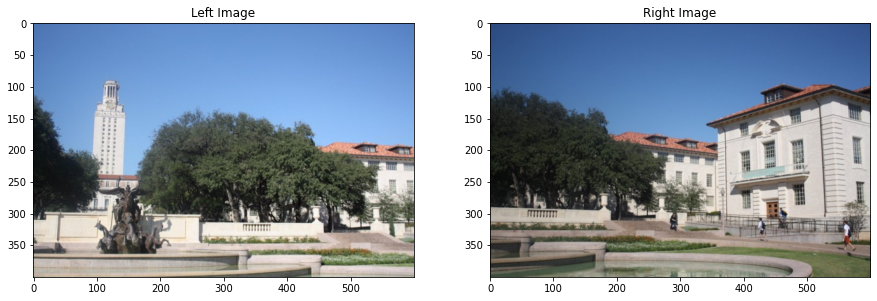

In [1]:
#Source: https://docs.opencv.org/4.0.0/d5/d48/samples_2python_2stitching_8py-example.html
%matplotlib inline
from matplotlib import pyplot as plt
import cv2
import numpy as np
import argparse
import sys

modes = (cv2.Stitcher_PANORAMA, cv2.Stitcher_SCANS)

# read input images
imgs = [cv2.imread("imgs/imgs/chapter9/left.jpeg", 1), 
        cv2.imread("imgs/imgs/chapter9/right.jpeg", 1)]


stitcher = cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
status, pano = stitcher.stitch(imgs)


f = plt.figure(figsize=(15,15))
f.add_subplot(1, 2, 1).set_title('Left Image');
plt.imshow(imgs[0][:,:,::-1])
f.add_subplot(1, 2, 2).set_title('Right Image');
plt.imshow(imgs[1][:,:,::-1]);
plt.show()

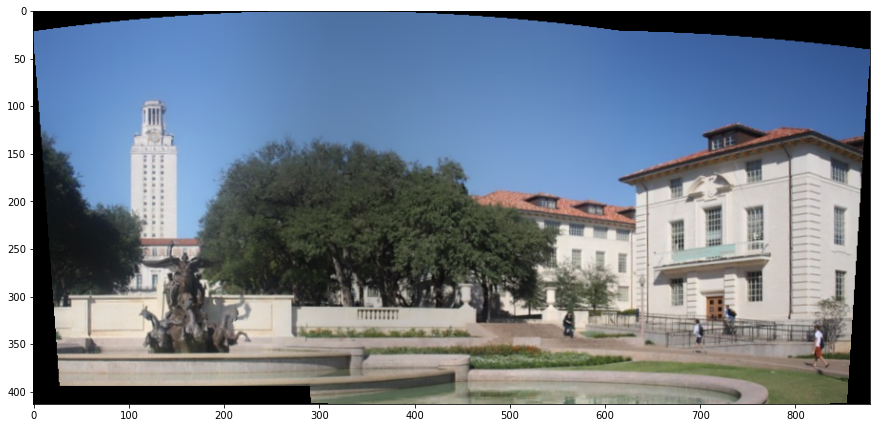

In [2]:
plt.figure(figsize=(15, 15))
plt.imshow(pano[:,:,::-1]);
plt.show()